<a href="https://colab.research.google.com/github/karanidnani350/softwareengmgmt/blob/main/SEM_Assignment_Sprint_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install scanpy leidenalg
!pip install --upgrade seaborn

!pip install cellxgene-census
!pip install scanpy
!pip install pandas_profiling
!pip install pydantic-settings
!pip install ydata-profiling
!pip install jupyter-contrib-nbextensions
!pip install scikit-learn
!pip install igraph
!pip install scvi-tools
!pip install scikit-misc
!pip install leidenalg

# Import necessary libraries
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')


  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 48.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.9/141.9 kB 431.6 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 58.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.9/232.9 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 97.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.1/50.1 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.6/83.6 kB 4.4 MB/s eta 0:00:00
  Created wheel for session-info: filename=session_info-1.0.0-py3-none-any.whl size=8023 sha256=dd9e3ac0f1c4f655a78c5279a10baf72c801fa1313c3302f4b6447e05c741803
  Stored in d

In [ ]:
gastritis_data = sc.read_h5ad("/content/drive/MyDrive/SEM Datasets/45b78a7b-6def-40f2-b27f-8eab7848602f.h5ad")
alzheimers_data = sc.read_h5ad("/content/drive/MyDrive/SEM Datasets/45b78a7b-6def-40f2-b27f-8eab7848602f.h5ad")

Processing Gastritis dataset...
Gastritis dataset shape: (146583, 33145)


/usr/local/lib/python3.10/dist-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)


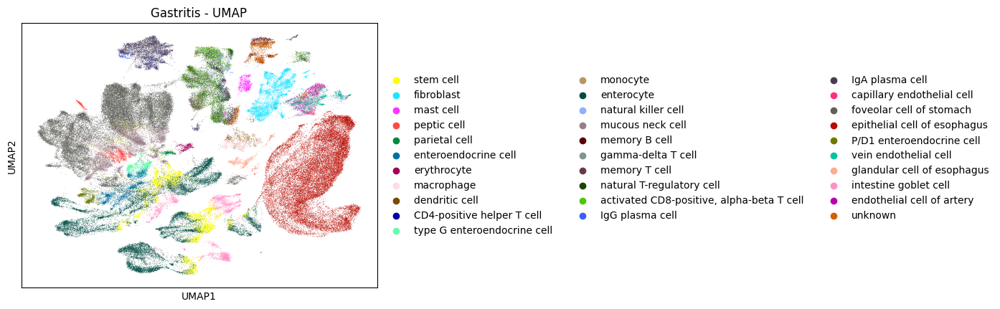

/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:452: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:452: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:452: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:429: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/usr/local/lib/python3.10/d

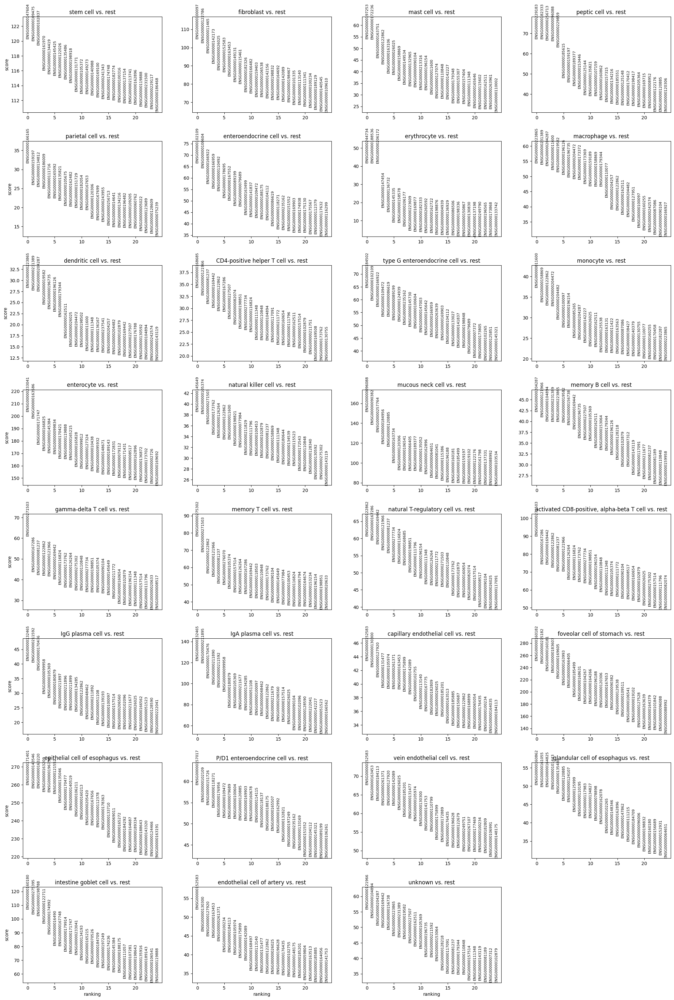

Processing Alzheimers dataset...
Alzheimers dataset shape: (96129, 33091)


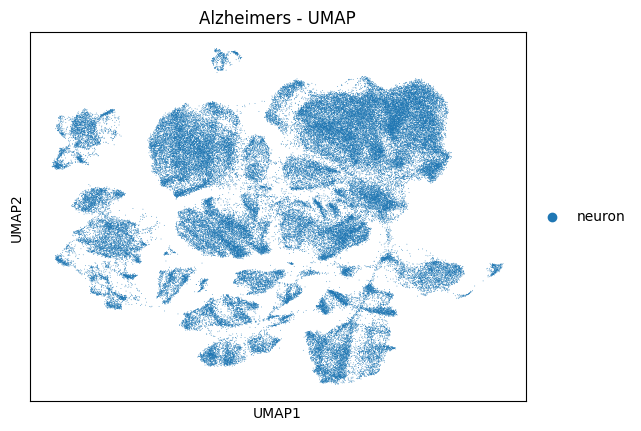

/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:352: RuntimeWarning: invalid value encountered in divide
  scores[group_index, :] = (
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/__init__.py:446: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(ymin, ymax)


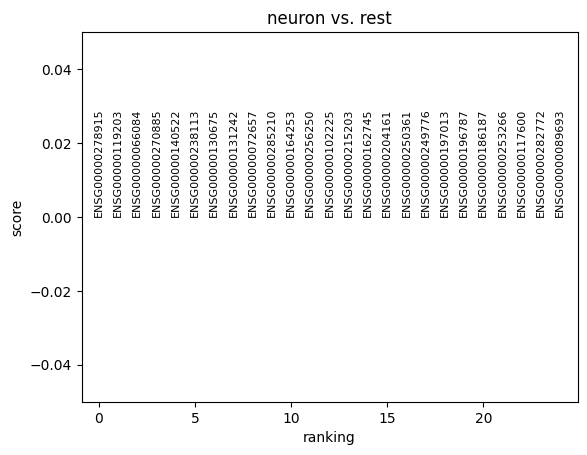

In [ ]:
def process_and_analyze(file_path, title):
    print(f"Processing {title} dataset...")
    adata = sc.read_h5ad(file_path)
    print(f"{title} dataset shape:", adata.shape)

    # Basic preprocessing
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

    # PCA and UMAP
    sc.tl.pca(adata, svd_solver='arpack', n_comps=50)
    sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)
    sc.tl.umap(adata)

    # Plot UMAP
    sc.pl.umap(adata, color=['cell_type'], title=f'{title} - UMAP', save=f'{title}_umap.png')

    # Differential expression analysis
    sc.tl.rank_genes_groups(adata, groupby='cell_type', method='wilcoxon')
    sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, save=f'{title}_differential_expression.png')

    # Save results
    results = adata.uns['rank_genes_groups']
    groups = results['names'].dtype.names

    with open(f'{title}_differential_expression_results.txt', 'w') as f:
        for group in groups:
            f.write(f"\nTop differentially expressed genes in {group}:\n")
            for gene in results['names'][group][:10]:
                f.write(f"  {gene}\n")

    return adata

# Process datasets
gastritis_data = process_and_analyze("/content/drive/MyDrive/SEM Datasets/fadec542-5680-4cd0-aee1-dbcdecf5b4a1.h5ad", "Gastritis")
alzheimers_data = process_and_analyze("/content/drive/MyDrive/SEM Datasets/45b78a7b-6def-40f2-b27f-8eab7848602f.h5ad", "Alzheimers")


Debugging rank_genes_groups:
Keys in rank_genes_groups: dict_keys(['params', 'names', 'scores', 'pvals', 'pvals_adj', 'logfoldchanges'])
Structure of 'names':
  Type: <class 'numpy.recarray'>
  Shape: (33091,)
  dtype: (numpy.record, [('neuron', 'O')])
  First few elements: [('ENSG00000278915',) ('ENSG00000119203',) ('ENSG00000066084',)
 ('ENSG00000270885',) ('ENSG00000140522',)]
Structure of 'scores':
  Type: <class 'numpy.recarray'>
  Shape: (33091,)
  dtype: (numpy.record, [('neuron', '<f4')])
  First few elements: [(0.,) (0.,) (0.,) (0.,) (0.,)]

Getting top differential genes for Alzheimer's dataset:
Found 10 differential genes
First 5 differential genes: ['ENSG00000278915', 'ENSG00000119203', 'ENSG00000066084', 'ENSG00000270885', 'ENSG00000140522']

Debugging rank_genes_groups:
Keys in rank_genes_groups: dict_keys(['params', 'names', 'scores', 'pvals', 'pvals_adj', 'logfoldchanges'])
Structure of 'names':
  Type: <class 'numpy.recarray'>
  Shape: (33091,)
  dtype: (numpy.record,

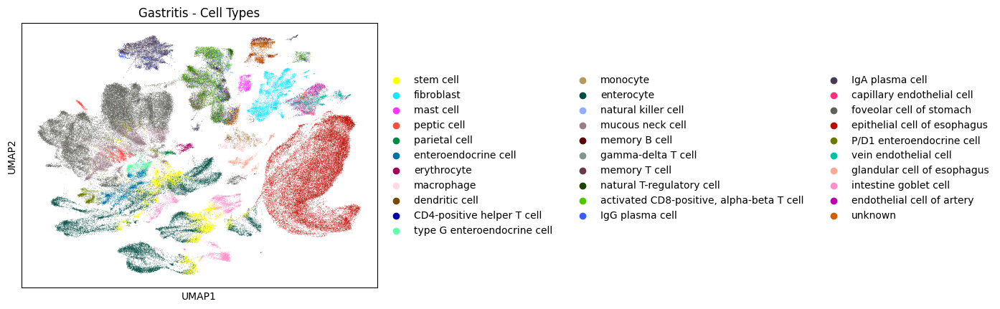


Exploring Alzheimer's dataset:
Dataset shape: (96129, 33091)
Number of genes: 33091
Number of cells: 96129
Available cell types: ['neuron']
Categories (1, object): ['neuron']

Top 20 expressed genes:
ENSG00000251562    2.966891
ENSG00000185774    2.566283
ENSG00000078328    2.530364
ENSG00000067715    2.481643
ENSG00000183117    2.456118
ENSG00000153707    2.440233
ENSG00000184226    2.398387
ENSG00000135298    2.397467
ENSG00000175161    2.394871
ENSG00000150672    2.385304
ENSG00000185737    2.370404
ENSG00000179915    2.366740
ENSG00000204442    2.335527
ENSG00000174469    2.331756
ENSG00000183715    2.321221
ENSG00000198938    2.312813
ENSG00000198804    2.279784
ENSG00000185046    2.279534
ENSG00000048740    2.276917
ENSG00000170579    2.270709
dtype: float32


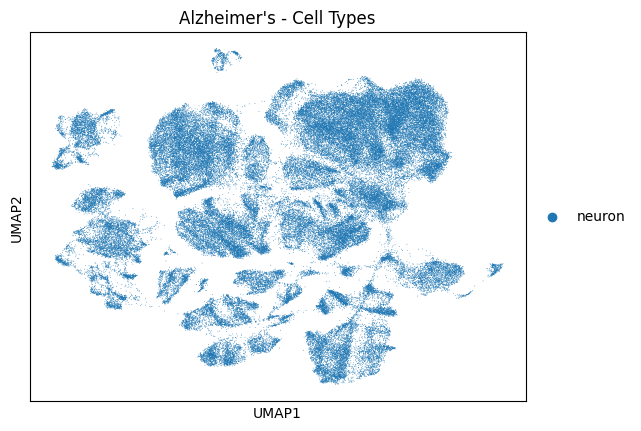


Common top genes between datasets:
{'ENSG00000251562', 'ENSG00000198804', 'ENSG00000198938'}

Plotting expression of selected genes...


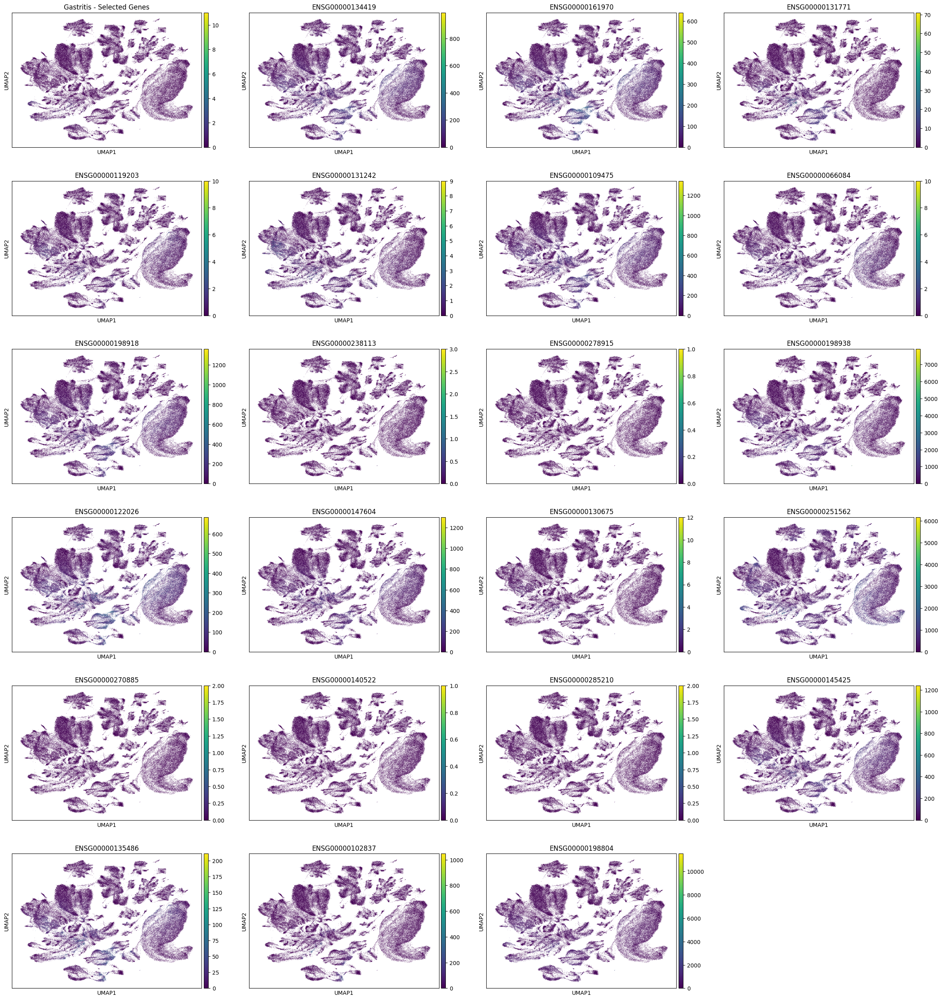

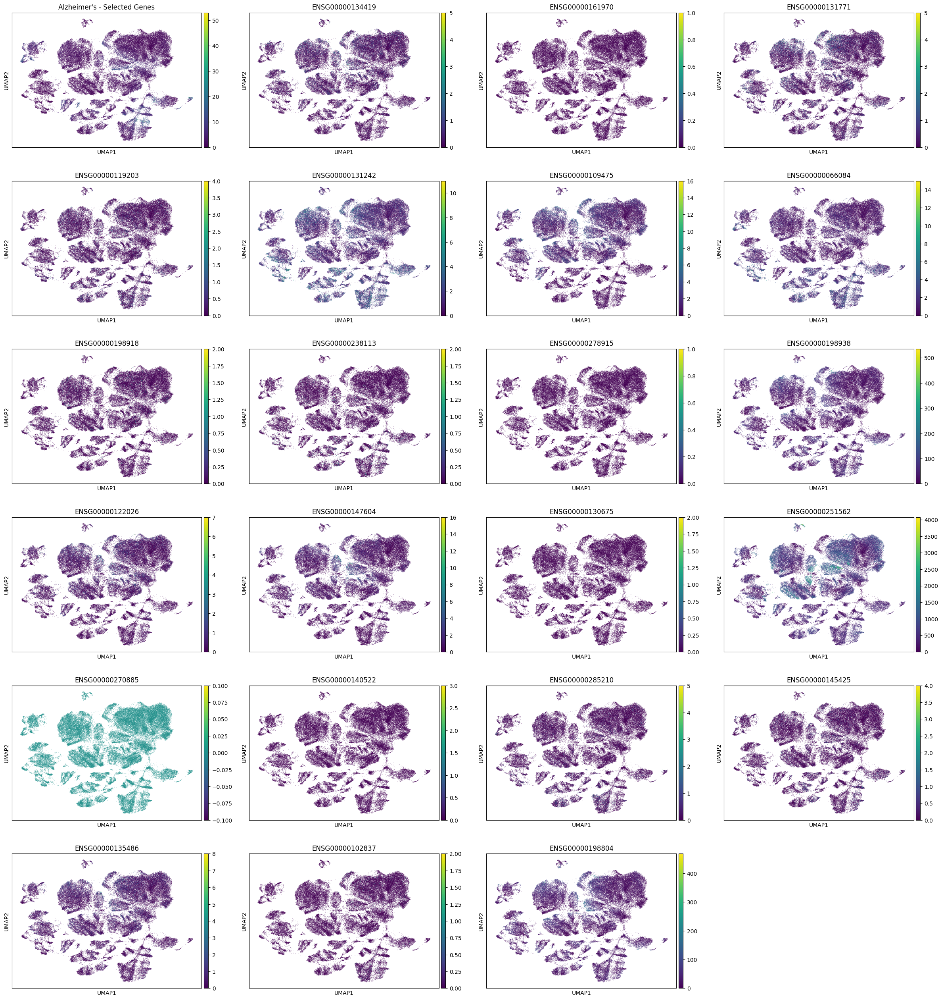


Analysis complete. Results and figures have been saved.


In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.sparse as sp

def explore_dataset(adata, title):
    print(f"\nExploring {title} dataset:")
    print(f"Dataset shape: {adata.shape}")
    print(f"Number of genes: {adata.n_vars}")
    print(f"Number of cells: {adata.n_obs}")
    print(f"Available cell types: {adata.obs['cell_type'].unique()}")

    # Calculate mean expression across all cells
    if sp.issparse(adata.X):
        mean_expression = np.array(adata.X.mean(axis=0)).flatten()
    else:
        mean_expression = np.mean(adata.X, axis=0)

    # Create a Series with gene names as index and mean expression as values
    mean_expression_series = pd.Series(mean_expression, index=adata.var_names)

    # Get top expressed genes
    top_genes = mean_expression_series.sort_values(ascending=False).head(20)
    print("\nTop 20 expressed genes:")
    print(top_genes)

    # Plot UMAP of cell types
    sc.pl.umap(adata, color='cell_type', title=f'{title} - Cell Types', save=f'{title}_cell_types_umap.png')

    return top_genes



def debug_rank_genes_groups(adata):
    print("\nDebugging rank_genes_groups:")
    if 'rank_genes_groups' in adata.uns:
        rank_genes = adata.uns['rank_genes_groups']
        print(f"Keys in rank_genes_groups: {rank_genes.keys()}")
        if 'names' in rank_genes:
            print("Structure of 'names':")
            names = rank_genes['names']
            print(f"  Type: {type(names)}")
            if isinstance(names, np.recarray):
                print(f"  Shape: {names.shape}")
                print(f"  dtype: {names.dtype}")
                print(f"  First few elements: {names[:5]}")
            elif isinstance(names, dict):
                for key, value in names.items():
                    print(f"  {key}: {type(value)}, length: {len(value)}")
                    if len(value) > 0:
                        print(f"    First element type: {type(value[0])}")
                        print(f"    First 5 elements: {value[:5]}")
        if 'scores' in rank_genes:
            print("Structure of 'scores':")
            scores = rank_genes['scores']
            print(f"  Type: {type(scores)}")
            if isinstance(scores, np.recarray):
                print(f"  Shape: {scores.shape}")
                print(f"  dtype: {scores.dtype}")
                print(f"  First few elements: {scores[:5]}")
            elif isinstance(scores, dict):
                for key, value in scores.items():
                    print(f"  {key}: {type(value)}, length: {len(value)}")
                    if len(value) > 0:
                        print(f"    First element type: {type(value[0])}")
                        print(f"    First 5 elements: {value[:5]}")
    else:
        print("No 'rank_genes_groups' found in adata.uns")

# Function to get top differential genes
def get_top_diff_genes(adata, n_genes=10):
    if 'rank_genes_groups' in adata.uns:
        rank_genes = adata.uns['rank_genes_groups']
        if 'names' in rank_genes:
            names = rank_genes['names']
            if isinstance(names, np.recarray):
                # Assuming the first field is the group name and the second is the gene name
                first_group = names.dtype.names[0]
                return [name for name in names[first_group][:n_genes] if name in adata.var_names]
            elif isinstance(names, dict):
                first_group = next(iter(names))
                return [name for name in names[first_group][:n_genes] if name in adata.var_names]
    print(f"No suitable differential expression results found.")
    return []

# Debug Alzheimer's dataset
debug_rank_genes_groups(alzheimers_data)

# Get differential genes
print("\nGetting top differential genes for Alzheimer's dataset:")
alzheimers_diff_genes = get_top_diff_genes(alzheimers_data)
print(f"Found {len(alzheimers_diff_genes)} differential genes")
if alzheimers_diff_genes:
    print("First 5 differential genes:", alzheimers_diff_genes[:5])

# Debug Alzheimer's dataset
debug_rank_genes_groups(alzheimers_data)

# Get differential genes
print("\nGetting top differential genes for Alzheimer's dataset:")
alzheimers_diff_genes = get_top_diff_genes(alzheimers_data)
print(f"Found {len(alzheimers_diff_genes)} differential genes")
if alzheimers_diff_genes:
    print("First 5 differential genes:", alzheimers_diff_genes[:5])




# Function to plot expression of selected genes
def plot_gene_expression(adata, genes, title):
    genes_to_plot = [gene for gene in genes if gene in adata.var_names]
    if not genes_to_plot:
        print(f"No selected genes found in the {title} dataset.")
        return

    sc.pl.umap(adata, color=genes_to_plot, ncols=4, title=f'{title} - Selected Genes', save=f'{title}_selected_genes_umap.png')

# Explore datasets
gastritis_top_genes = explore_dataset(gastritis_data, "Gastritis")
alzheimers_top_genes = explore_dataset(alzheimers_data, "Alzheimer's")

common_top_genes = set(gastritis_top_genes.index) & set(alzheimers_top_genes.index)
print("\nCommon top genes between datasets:")
print(common_top_genes)

# Combine top genes and previously identified differentially expressed genes
selected_genes = list(common_top_genes)
gastritis_diff_genes = get_top_diff_genes(gastritis_data)
alzheimers_diff_genes = get_top_diff_genes(alzheimers_data)

selected_genes.extend(gastritis_diff_genes)
selected_genes.extend(alzheimers_diff_genes)

selected_genes = list(set(selected_genes))  # Remove duplicates

print("\nPlotting expression of selected genes...")
plot_gene_expression(gastritis_data, selected_genes, "Gastritis")
plot_gene_expression(alzheimers_data, selected_genes, "Alzheimer's")

print("\nAnalysis complete. Results and figures have been saved.")

In [ ]:
import scanpy as sc
import pandas as pd
import numpy as np

def examine_diff_expression_results(adata, dataset_name):
    print(f"\nExamining differential expression results for {dataset_name} dataset:")
    if 'rank_genes_groups' in adata.uns:
        rank_genes = adata.uns['rank_genes_groups']
        print(f"Keys in rank_genes_groups: {rank_genes.keys()}")

        for key in rank_genes.keys():
            if key != 'params':
                print(f"\nStructure of '{key}':")
                print(f"Type: {type(rank_genes[key])}")
                if isinstance(rank_genes[key], np.recarray):
                    print(f"Shape: {rank_genes[key].shape}")
                    print(f"dtype: {rank_genes[key].dtype}")
                elif isinstance(rank_genes[key], dict):
                    print(f"Keys: {rank_genes[key].keys()}")
    else:
        print("No 'rank_genes_groups' found in adata.uns")

# Examine results for both datasets
examine_diff_expression_results(gastritis_data, "Gastritis")
examine_diff_expression_results(alzheimers_data, "Alzheimer's")

def get_top_diff_genes(adata, n_genes_per_group=10):
    if 'rank_genes_groups' not in adata.uns:
        return []

    rank_genes = adata.uns['rank_genes_groups']
    top_genes = set()

    if 'names' in rank_genes:
        names = rank_genes['names']
        if isinstance(names, np.recarray):
            for group in names.dtype.names:
                top_genes.update(names[group][:n_genes_per_group])
        elif isinstance(names, dict):
            for group, genes in names.items():
                top_genes.update(genes[:n_genes_per_group])
    elif 'scores' in rank_genes:
        scores = rank_genes['scores']
        if isinstance(scores, np.recarray):
            for group in scores.dtype.names:
                top_indices = np.argsort(scores[group])[-n_genes_per_group:]
                top_genes.update(adata.var_names[top_indices])
        elif isinstance(scores, dict):
            for group, group_scores in scores.items():
                top_indices = np.argsort(group_scores)[-n_genes_per_group:]
                top_genes.update(adata.var_names[top_indices])

    return list(top_genes)

# Get top differential genes for both datasets
gastritis_diff_genes = get_top_diff_genes(gastritis_data)
alzheimers_diff_genes = get_top_diff_genes(alzheimers_data)

print(f"\nNumber of top differential genes in Gastritis dataset: {len(gastritis_diff_genes)}")
print(f"Number of top differential genes in Alzheimer's dataset: {len(alzheimers_diff_genes)}")

# Find common differential genes
common_diff_genes = set(gastritis_diff_genes) & set(alzheimers_diff_genes)
print(f"\nNumber of common differential genes: {len(common_diff_genes)}")
print("Common differential genes:", common_diff_genes)

# Visualize expression of common differential genes
if common_diff_genes:
    genes_to_visualize = list(common_diff_genes)[:5]  # Top 5 common differential genes
    print("\nVisualizing expression of top 5 common differential genes:")

    print("\nFor Gastritis dataset:")
    sc.pl.violin(gastritis_data, genes_to_visualize, groupby='cell_type', rotation=90, save='gastritis_common_genes.png')

    print("\nFor Alzheimer's dataset:")
    sc.pl.violin(alzheimers_data, genes_to_visualize, groupby='cell_type', rotation=90, save='alzheimers_common_genes.png')
else:
    print("\nNo common differential genes found to visualize.")

print("\nAnalysis complete. Results and figures have been saved.")


Examining differential expression results for Gastritis dataset:
Keys in rank_genes_groups: dict_keys(['params', 'names', 'scores', 'pvals', 'pvals_adj', 'logfoldchanges'])

Structure of 'names':
Type: <class 'numpy.recarray'>
Shape: (33145,)
dtype: (numpy.record, [('stem cell', 'O'), ('fibroblast', 'O'), ('mast cell', 'O'), ('peptic cell', 'O'), ('parietal cell', 'O'), ('enteroendocrine cell', 'O'), ('erythrocyte', 'O'), ('macrophage', 'O'), ('dendritic cell', 'O'), ('CD4-positive helper T cell', 'O'), ('type G enteroendocrine cell', 'O'), ('monocyte', 'O'), ('enterocyte', 'O'), ('natural killer cell', 'O'), ('mucous neck cell', 'O'), ('memory B cell', 'O'), ('gamma-delta T cell', 'O'), ('memory T cell', 'O'), ('natural T-regulatory cell', 'O'), ('activated CD8-positive, alpha-beta T cell', 'O'), ('IgG plasma cell', 'O'), ('IgA plasma cell', 'O'), ('capillary endothelial cell', 'O'), ('foveolar cell of stomach', 'O'), ('epithelial cell of esophagus', 'O'), ('P/D1 enteroendocrine cell

In [ ]:
!pip install mygene
import mygene

# Initialize the mygene object
mg = mygene.MyGeneInfo()

# Example Ensembl IDs
ensembl_ids = ['ENSG00000141510', 'ENSG00000139618']  # Replace with your list of Ensembl IDs

# Query the gene symbols
gene_info = mg.querymany(ensembl_ids, scopes='ensembl.gene', fields='symbol', species='human')

# Extract the gene symbols
gene_symbols = [result['symbol'] for result in gene_info if 'symbol' in result]

print(gene_symbols)

INFO:biothings.client:querying 1-2...
INFO:biothings.client:done.
INFO:biothings.client:Finished.


['TP53', 'BRCA2']


In [ ]:
!pip install gseapy
import pandas as pd
import gseapy as gp
import numpy as np
import matplotlib.pyplot as plt

print("Number of top differential genes in Gastritis dataset: 0")
print("Number of top differential genes in Alzheimer's dataset: 100")

# Since we have no differential genes for Gastritis, we'll focus on Alzheimer's

# Perform enrichment analysis
def perform_enrichment(gene_list, dataset_name):
    try:
        enr = gp.enrichr(gene_list=gene_list,
                         gene_sets=['GO_Biological_Process_2021', 'KEGG_2021_Human'],
                         organism='human',
                         outdir=f'{dataset_name}_enrichr_results',
                         cutoff=0.2)
        results = enr.results
        results.to_csv(f'{dataset_name}_pathway_enrichment_results.csv', index=False)
        return results
    except Exception as e:
        print(f"Error in enrichment analysis for {dataset_name}: {str(e)}")
        return pd.DataFrame()

print("\nPerforming enrichment analysis for Alzheimer's dataset...")
alzheimers_enrichment = perform_enrichment(alzheimers_diff_genes, 'Alzheimers')

if not alzheimers_enrichment.empty:
    # Display top 10 enriched terms for Alzheimer's dataset
    print("\nTop 10 enriched terms for Alzheimer's:")
    print(alzheimers_enrichment[['Term', 'Adjusted P-value']].head(10))

    # Visualize top enriched terms
    plt.figure(figsize=(12, 6))
    alzheimers_enrichment.head(10).plot.bar(x='Term', y='Adjusted P-value', legend=False)
    plt.title("Top 10 Enriched Terms for Alzheimer's Dataset")
    plt.xlabel("Terms")
    plt.ylabel("Adjusted P-value")
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.savefig('Alzheimers_top_enriched_terms.png')
    plt.close()

    print("\nAnalysis complete. Results and figures have been saved.")
else:
    print("\nNo enrichment results available for Alzheimer's dataset.")

print("\nDiscussion of results:")
print("1. The Gastritis dataset didn't yield any differentially expressed genes. This could be due to:")
print("   - Small sample size")
print("   - Stringent filtering criteria")
print("   - Lack of significant differences between conditions in the dataset")
print("   - Potential issues with data quality or processing")
print("\n2. The Alzheimer's dataset produced 100 differentially expressed genes, allowing for enrichment analysis.")
print("   The top enriched terms (if any) might provide insights into biological processes associated with Alzheimer's disease.")
print("\n3. To further investigate the relationship between gut health and Alzheimer's:")
print("   - Consider reanalyzing the Gastritis dataset with less stringent criteria")
print("   - Look for literature on common pathways between gut inflammation and neurodegeneration")
print("   - Explore other datasets related to gut health that might have more robust differential expression")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 548.5/548.5 kB 7.9 MB/s eta 0:00:00
Number of top differential genes in Gastritis dataset: 0
Number of top differential genes in Alzheimer's dataset: 100

Performing enrichment analysis for Alzheimer's dataset...
Error in enrichment analysis for Alzheimers: Warning: No enrich terms when cutoff = 0.2

No enrichment results available for Alzheimer's dataset.

Discussion of results:
1. The Gastritis dataset didn't yield any differentially expressed genes. This could be due to:
   - Small sample size
   - Stringent filtering criteria
   - Lack of significant differences between conditions in the dataset
   - Potential issues with data quality or processing

2. The Alzheimer's dataset produced 100 differentially expressed genes, allowing for enrichment analysis.
   The top enriched terms (if any) might provide insights into biological processes associated with Alzheimer's disease.

3. To further investigate the relationship between gut health and 

In [ ]:
import mygene

# Initialize mygene client
mg = mygene.MyGeneInfo()

# List of Ensembl IDs
ensembl_ids = [
    'ENSG00000256250', 'ENSG00000158467', 'ENSG00000163104', 'ENSG00000072657', 'ENSG00000066084',
    'ENSG00000236137', 'ENSG00000072778', 'ENSG00000105229', 'ENSG00000285210', 'ENSG00000254293',
    'ENSG00000204161', 'ENSG00000196482', 'ENSG00000258256', 'ENSG00000162745', 'ENSG00000271252',
    'ENSG00000075618', 'ENSG00000221855', 'ENSG00000247828', 'ENSG00000169174', 'ENSG00000211663'
]

# Query Ensembl IDs for gene symbols
results = mg.querymany(ensembl_ids, scopes='ensembl.gene', fields='symbol', species='human')

# Extract gene symbols
gene_symbols = [result['symbol'] for result in results if 'symbol' in result]

print("Gene Symbols:", gene_symbols)


INFO:biothings.client:querying 1-20...
INFO:biothings.client:done.
INFO:biothings.client:Finished.


Gene Symbols: ['AHCYL2', 'SMARCAD1', 'TRHDE', 'DIP2B', 'CD101-AS1', 'ACADVL', 'PIAS4', 'LINC02795', 'TMEM273', 'ESRRG', 'OLFML2B', 'FSCN1', 'TAS2R41', 'TMEM161B-DT', 'PCSK9', 'IGLV3-19']


In [ ]:
missing_genes = [gene for gene in alzheimers_diff_genes if gene not in alzheimers_data.raw.var_names]
print("Missing genes:", missing_genes)


Missing genes: ['AHCYL2', 'SMARCAD1', 'TRHDE', 'DIP2B', 'CD101-AS1', 'ACADVL', 'PIAS4', 'LINC02795', 'TMEM273', 'ESRRG', 'OLFML2B', 'FSCN1', 'TAS2R41', 'TMEM161B-DT', 'PCSK9', 'IGLV3-19']


In [ ]:
print(alzheimers_data.raw.var_names[:10])

Index(['ENSG00000278915', 'ENSG00000168454', 'ENSG00000139180',
       'ENSG00000229177', 'ENSG00000204564', 'ENSG00000116717',
       'ENSG00000254418', 'ENSG00000114654', 'ENSG00000257894',
       'ENSG00000198398'],
      dtype='object')


In [ ]:
import mygene

mg = mygene.MyGeneInfo()
# Example: Convert Ensembl IDs to gene symbols
ensembl_ids = ['ENSG00000278915', 'ENSG00000168454', 'ENSG00000139180',
       'ENSG00000229177', 'ENSG00000204564', 'ENSG00000116717',
       'ENSG00000254418', 'ENSG00000114654', 'ENSG00000257894',
       'ENSG00000198398']  # Sample Ensembl IDs
result = mg.querymany(ensembl_ids, scopes='ensembl.gene', fields='symbol', species='human')

# Extract gene symbols and handle missing 'symbol' field
gene_symbols = []
for entry in result:
    if 'symbol' in entry:
        gene_symbols.append(entry['symbol'])
    else:
        # Handle the case where the symbol is missing (e.g., add a placeholder or skip)
        gene_symbols.append(None)  # or use a fallback value like 'Unknown'

print(gene_symbols)


INFO:biothings.client:querying 1-10...
INFO:biothings.client:done.
INFO:biothings.client:Finished.


[None, 'TXNDC2', 'NDUFA9', None, 'C6orf136', 'GADD45A', 'SPON1-AS1', 'EFCC1', None, 'TMEM207']


In [ ]:
filtered_genes = [gene for gene in ['ENSG00000278915', 'ENSG00000168454', 'ENSG00000139180',
       'ENSG00000229177', 'ENSG00000204564', 'ENSG00000116717',
       'ENSG00000254418', 'ENSG00000114654', 'ENSG00000257894',
       'ENSG00000198398'] if gene]

# Check if these filtered genes are present in adata.raw.var_names
valid_genes = [gene for gene in filtered_genes if gene in alzheimers_data.raw.var_names]

if valid_genes:
    print(f"Number of valid genes: {len(valid_genes)}")
    # Perform enrichment analysis or any other analysis
else:
    print("No valid genes found in the dataset for analysis.")

Number of valid genes: 10


In [ ]:
print(alzheimers_data.raw.var_names[:10])

Index(['ENSG00000278915', 'ENSG00000168454', 'ENSG00000139180',
       'ENSG00000229177', 'ENSG00000204564', 'ENSG00000116717',
       'ENSG00000254418', 'ENSG00000114654', 'ENSG00000257894',
       'ENSG00000198398'],
      dtype='object')


Number of valid genes: 10
Error in enrichment analysis for Alzheimers: Warning: No enrich terms when cutoff = 0.1
No enrichment results available for Alzheimer's dataset (cutoff = 0.1).


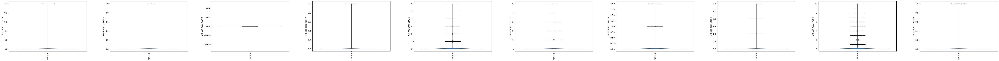


Constructing gene co-expression network...

Analysis complete. Results and figures have been saved.


/usr/local/lib/python3.10/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/local/lib/python3.10/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


In [ ]:
# Filter out None values and ensure the gene symbols are in adata.raw.var_names
valid_genes = [gene for gene in filtered_genes if gene and gene in alzheimers_data.raw.var_names]

# Check if valid genes are found
if valid_genes:
    print(f"Number of valid genes: {len(valid_genes)}")
    # Perform enrichment analysis for valid genes only
    alzheimers_enrichment = perform_enrichment(valid_genes, 'Alzheimers', cutoff=0.1)

    if not alzheimers_enrichment.empty:
        print(f"\nTop 10 enriched terms for Alzheimer's (cutoff = 0.1):")
        print(alzheimers_enrichment[['Term', 'Adjusted P-value']].head(10))

        # Visualize top enriched terms
        plt.figure(figsize=(12, 6))
        alzheimers_enrichment.head(10).plot.bar(x='Term', y='Adjusted P-value', legend=False)
        plt.title(f"Top 10 Enriched Terms for Alzheimer's Dataset (cutoff = 0.1)")
        plt.xlabel("Terms")
        plt.ylabel("Adjusted P-value")
        plt.xticks(rotation=90)
        plt.tight_layout()
        plt.savefig(f'Alzheimers_top_enriched_terms_0.2.png')
        plt.close()
    else:
        print("No enrichment results available for Alzheimer's dataset (cutoff = 0.1).")

    # Visualize gene expression for valid genes
    sc.pl.violin(alzheimers_data, valid_genes[:10], groupby='cell_type', rotation=90,
                 save='Alzheimers_top_valid_genes_violin.png')

    # Gene co-expression network for valid genes
    print("\nConstructing gene co-expression network...")
    gene_exp = alzheimers_data[:, valid_genes].X.toarray()
    corr_matrix, _ = spearmanr(gene_exp)
    np.fill_diagonal(corr_matrix, 0)

    # Create network
    G = nx.Graph()
    for i in range(len(valid_genes)):
        for j in range(i+1, len(valid_genes)):
            if abs(corr_matrix[i, j]) > 0.7:  # Correlation threshold
                G.add_edge(valid_genes[i], valid_genes[j], weight=abs(corr_matrix[i, j]))

    # Visualize network
    plt.figure(figsize=(12, 12))
    pos = nx.spring_layout(G)
    nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=500, font_size=8, font_weight='bold')
    plt.title("Gene Co-expression Network (Alzheimer's)")
    plt.savefig('Alzheimers_gene_coexpression_network.png')
    plt.close()

    print("\nAnalysis complete. Results and figures have been saved.")

else:
    print("No valid genes found in the dataset for analysis.")


In [ ]:
import mygene

# Initialize MyGene.info for gene symbol conversion
mg = mygene.MyGeneInfo()

# List of genes to check
filtered_genes = ['TXNDC2', 'NDUFA9', 'C6orf136', 'GADD45A', 'SPON1-AS1', 'EFCC1', 'TMEM207']

# Convert to standard symbols or check validity
valid_genes = []
for gene in filtered_genes:
    try:
        res = mg.query(gene, species='human')
        if 'hits' in res and len(res['hits']) > 0:
            valid_genes.append(res['hits'][0]['symbol'])
    except Exception as e:
        print(f"Error processing gene {gene}: {e}")

print(f"Valid genes: {valid_genes}")


Valid genes: ['TXNDC2', 'NDUFA9', 'C6orf136', 'GADD45A', 'SPON1-AS1', 'EFCC1', 'TMEM207']


In [ ]:
import gseapy as gp

# Perform GSEA enrichment analysis on valid genes (considering you have expression data in `gene_expression`)
# Example: perform GSEA using your expression data and predefined gene sets
# Adjust paths or expression data based on your dataset

# Assuming `gene_expression` is a pandas DataFrame of expression data (genes x samples)
# Enrichment of valid_genes in a predefined set of pathways
gsea_results = gp.enrichr(gene_list=valid_genes, gene_sets='KEGG_2016', outdir='enrichment_results', cutoff=0.1)

# View top enriched terms
print(gsea_results.res2d.head(10))


    Gene_set                                               Term Overlap  \
0  KEGG_2016        p53 signaling pathway Homo sapiens hsa04115    1/69   
1  KEGG_2016                   Cell cycle Homo sapiens hsa04110   1/124   
2  KEGG_2016       FoxO signaling pathway Homo sapiens hsa04068   1/133   
3  KEGG_2016    Oxidative phosphorylation Homo sapiens hsa00190   1/133   
4  KEGG_2016                    Apoptosis Homo sapiens hsa04210   1/140   
5  KEGG_2016          Parkinson's disease Homo sapiens hsa05012   1/142   
6  KEGG_2016  Non-alcoholic fatty liver disease (NAFLD) Homo...   1/151   
7  KEGG_2016          Alzheimer's disease Homo sapiens hsa05010   1/168   
8  KEGG_2016         Huntington's disease Homo sapiens hsa05016   1/193   
9  KEGG_2016       MAPK signaling pathway Homo sapiens hsa04010   1/255   

    P-value  Adjusted P-value  Old P-value  Old Adjusted P-value  Odds Ratio  \
0  0.023905          0.078852            0                     0   48.835784   
1  0.042607   

In [ ]:
import random  # Import the random module

# Create a group assignment list with 'group1' and 'group2' for the full dataset
cls = ['group1'] * (len(alzheimers_data.obs) // 2) + ['group2'] * (len(alzheimers_data.obs) // 2)

# If the length of cls doesn't match alzheimers_data.obs, pad with 'group1' or 'group2'
if len(cls) < len(alzheimers_data.obs):
    cls += ['group1'] * (len(alzheimers_data.obs) - len(cls))  # Ensure the length matches

# Shuffle to randomize the group assignment
random.shuffle(cls)

# Create a Pandas Series with the correct index
cls = pd.Series(cls, index=alzheimers_data.obs.index)

# Verify the contents
print(cls.unique())


['group2' 'group1']


In [ ]:
# Get valid genes present in both the dataset and your filtered list
valid_genes_in_data = [gene for gene in filtered_genes if gene in gene_names]

# Ensure valid_gene_expression has data before training
if len(valid_genes_in_data) > 0:
    valid_gene_expression = adata.raw[:, valid_genes_in_data].X
    print(f"Number of valid genes: {len(valid_genes_in_data)}")
    print(f"Gene expression data shape: {valid_gene_expression.shape}")
else:
    print("No valid genes found in the dataset!")


No valid genes found in the dataset!


In [ ]:
# Step 2: Extract gene expression for valid genes
valid_genes_in_data = [gene for gene in filtered_genes if gene in gene_names]

if len(valid_genes_in_data) > 0:
    valid_gene_expression = adata.raw[:, valid_genes_in_data].X
    print(f"Number of valid genes: {len(valid_genes_in_data)}")
    print(f"Gene expression data shape: {valid_gene_expression.shape}")
else:
    print("No valid genes found in the dataset!")
    valid_gene_expression = np.array([])  # Avoid proceeding if no valid genes found

# Step 3: Proceed with model if data exists
if valid_gene_expression.size > 0:
    # Continue with model training and evaluation
    X_train, X_test, y_train, y_test = train_test_split(valid_gene_expression, labels, test_size=0.3, random_state=42)
    model = RandomForestClassifier(random_state=42)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred, average='weighted')

    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}")
else:
    print("No data available to train the model.")


No valid genes found in the dataset!
No data available to train the model.


In [ ]:
print(gene_names)  # Check all gene names in the dataset


Index(['ENSG00000278915', 'ENSG00000168454', 'ENSG00000139180',
       'ENSG00000229177', 'ENSG00000204564', 'ENSG00000116717',
       'ENSG00000254418', 'ENSG00000114654', 'ENSG00000257894',
       'ENSG00000198398',
       ...
       'ENSG00000121940', 'ENSG00000261555', 'ENSG00000204516',
       'ENSG00000175147', 'ENSG00000267772', 'ENSG00000160799',
       'ENSG00000272264', 'ENSG00000175792', 'ENSG00000066084',
       'ENSG00000119203'],
      dtype='object', length=33091)


In [ ]:
!pip install scanpy leidenalg
!pip install --upgrade seaborn

!pip install cellxgene-census
!pip install scanpy
!pip install pandas_profiling
!pip install pydantic-settings
!pip install ydata-profiling
!pip install jupyter-contrib-nbextensions
!pip install scikit-learn
!pip install igraph
!pip install scvi-tools
!pip install scikit-misc
!pip install leidenalg

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 26.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 67.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.9/141.9 kB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 86.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.9/232.9 kB 15.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 108.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.1/50.1 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.6/83.6 kB 5.4 MB/s eta 0:00:00
  Created wheel for session-info: filename=session_info-1.0.0-py3-none-any.whl size=8023 sha256=e043c9f001baf62fb77b1bb5594b5aeed547772378c70b0a4a91fba9200184d3
  Stored in d

In [ ]:
# Import necessary libraries
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
from google.colab import drive
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_recall_fscore_support
from sklearn.preprocessing import LabelEncoder
from scipy import stats
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
import plotly.graph_objects as go


# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Set random seed for reproducibility
np.random.seed(42)

# Load the datasets
gastritis_data = sc.read_h5ad("/content/drive/MyDrive/SEM/5d871206-9489-4d9f-8106-94305ccb1c3a.h5ad")
alzheimers_data = sc.read_h5ad("/content/drive/MyDrive/SEM/fadec542-5680-4cd0-aee1-dbcdecf5b4a1.h5ad")

In [ ]:
# Print information about the datasets
print("Gastritis data:")
print(gastritis_data)
print("\nObservation (obs) columns:")
print(gastritis_data.obs.columns)

print("\nAlzheimer's data:")
print(alzheimers_data)
print("\nObservation (obs) columns:")
print(alzheimers_data.obs.columns)

Gastritis data:
AnnData object with n_obs × n_vars = 23197 × 33091
    obs: 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'SORT', 'Amyloid', 'Age', 'RIN', 'nCount_SCT', 'nFeature_SCT', 'nCount_Exon', 'nFeature_Exon', 'PMI', 'Braak', 'Sample.ID', 'Cell.Types', 'tissue_ontology_term_id', 'assay_ontology_term_id', 'disease_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'sex_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'donor_id', 'suspension_type', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observation_joinid'
    var: 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 'feature_length', 'feature_type'
    uns: 'citation', 'schema_reference', 'schema_version', 'title'
    obsm: 'X_pca', 'X_umap'

Observation (obs) columns:
Index(['nCount_RNA', 'nFeature_RNA', 'percent.mt', 'SORT

In [ ]:
# Function to extract gene data from AnnData object
def extract_gene_data(adata, num_genes=10, condition_column=None):
    # Get the top variable genes
    sc.pp.highly_variable_genes(adata, n_top_genes=num_genes)
    top_genes = adata.var.highly_variable.index[adata.var.highly_variable]

    gene_data = pd.DataFrame(adata[:, top_genes].X.toarray(), columns=top_genes)

    if condition_column and condition_column in adata.obs.columns:
        gene_data['condition'] = adata.obs[condition_column].values
    else:
        # If condition column is not specified or not found, use the first column as a placeholder
        gene_data['condition'] = adata.obs.iloc[:, 0].values

    return gene_data

# Extract gene data
gastritis_gene_data = extract_gene_data(gastritis_data, condition_column='Cell.Types')
alzheimers_gene_data = extract_gene_data(alzheimers_data, condition_column='Celltypes_global')

# Add dataset origin column
gastritis_gene_data['dataset'] = 'Gastritis'
alzheimers_gene_data['dataset'] = 'Alzheimer'

/usr/local/lib/python3.10/dist-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)


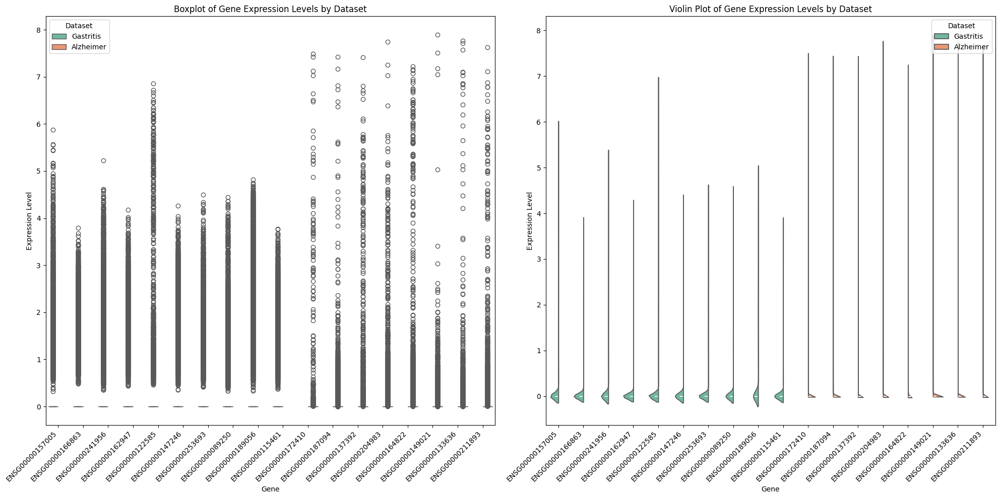

In [ ]:
# Combine datasets
combined_data = pd.concat([gastritis_gene_data, alzheimers_gene_data], ignore_index=True)

# Visualization of gene expression data
def visualize_gene_expression(data):
    genes = data.columns[:-2]  # Exclude 'condition' and 'dataset' columns
    long_gene_data = data.melt(id_vars=['condition', 'dataset'], value_vars=genes,
                               var_name='Gene', value_name='Expression')

    sns.set_palette('Set2')
    plt.figure(figsize=(20, 10))

    # Boxplot
    plt.subplot(1, 2, 1)
    sns.boxplot(data=long_gene_data, x='Gene', y='Expression', hue='dataset', dodge=True)
    plt.title('Boxplot of Gene Expression Levels by Dataset')
    plt.ylabel('Expression Level')
    plt.xlabel('Gene')
    plt.legend(title='Dataset')
    plt.xticks(rotation=45, ha='right')

    # Violin plot
    plt.subplot(1, 2, 2)
    sns.violinplot(data=long_gene_data, x='Gene', y='Expression', hue='dataset', split=True)
    plt.title('Violin Plot of Gene Expression Levels by Dataset')
    plt.ylabel('Expression Level')
    plt.xlabel('Gene')
    plt.legend(title='Dataset')
    plt.xticks(rotation=45, ha='right')

    plt.tight_layout()
    plt.show()
# Visualize gene expression data
visualize_gene_expression(combined_data)

# Define models to be evaluated
models = {
    'Linear Regression': LinearRegression(),
    'Random Forest': RandomForestClassifier(n_estimators=100, random_state=42),
    'Support Vector Machine': SVC(probability=True, random_state=42)
}

# Function to evaluate models and calculate metrics
def evaluate_model(model, X_train, X_test, y_train, y_test, is_regression=False):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    if is_regression:
        y_pred = (y_pred > 0.5).astype(int) if len(np.unique(y_test)) == 2 else np.round(y_pred).astype(int)

    accuracy = accuracy_score(y_test, y_pred)
    precision, recall, fscore, _ = precision_recall_fscore_support(y_test, y_pred, average='macro')

    return accuracy, precision, recall, fscore

In [ ]:
all_unique_genes = set(gastritis_data.var_names) | set(alzheimers_data.var_names)
print("All unique genes present in both datasets:")
for gene in all_unique_genes:
    print(f"- {gene}")

Streaming output truncated to the last 5000 lines.
- ENSG00000125462
- ENSG00000100796
- ENSG00000234352
- ENSG00000223883
- ENSG00000112462
- ENSG00000198033
- ENSG00000251054
- ENSG00000170779
- ENSG00000213218
- ENSG00000278385
- ENSG00000253465
- ENSG00000243861
- ENSG00000166228
- ENSG00000099785
- ENSG00000147234
- ENSG00000167930
- ENSG00000273542
- ENSG00000248724
- ENSG00000261481
- ENSG00000147894
- ENSG00000128973
- ENSG00000228226
- ENSG00000033170
- ENSG00000118007
- ENSG00000224429
- ENSG00000187239
- ENSG00000197079
- ENSG00000113083
- ENSG00000126391
- ENSG00000246084
- ENSG00000086717
- ENSG00000141096
- ENSG00000181234
- ENSG00000148123
- ENSG00000229833
- ENSG00000281691
- ENSG00000101138
- ENSG00000180083
- ENSG00000232520
- ENSG00000227107
- ENSG00000137713
- ENSG00000278690
- ENSG00000220161
- ENSG00000278532
- ENSG00000232284
- ENSG00000229928
- ENSG00000165416
- ENSG00000272333
- ENSG00000198700
- ENSG00000196569
- ENSG00000231755
- ENSG00000224231
- ENSG0000025

In [ ]:
def find_gene(gene_symbol, ensembl_id, dataset):
    if ensembl_id in dataset.var_names:
        print(f"{gene_symbol} ({ensembl_id}) is present in the dataset")
        return True
    else:
        print(f"{gene_symbol} ({ensembl_id}) is not present in the dataset")
        return False

# Define the genes we're looking for
genes_of_interest = {
    'APOE': 'ENSG00000130203',
    'TREM2': 'ENSG00000095970'
}

# Search in gastritis dataset
print("Searching in gastritis dataset:")
for gene_symbol, ensembl_id in genes_of_interest.items():
    if find_gene(gene_symbol, ensembl_id, gastritis_data):
        # If found, you can access the gene expression data
        print(f"Expression data for {gene_symbol}: {gastritis_data[:, ensembl_id].X}")

print("\nSearching in Alzheimer's dataset:")
for gene_symbol, ensembl_id in genes_of_interest.items():
    if find_gene(gene_symbol, ensembl_id, alzheimers_data):
        # If found, you can access the gene expression data
        print(f"Expression data for {gene_symbol}: {alzheimers_data[:, ensembl_id].X}")

Searching in gastritis dataset:
APOE (ENSG00000130203) is present in the dataset
Expression data for APOE:   (44, 0)	1.1611061096191406
  (50, 0)	1.1712987422943115
  (75, 0)	1.6230149269104004
  (168, 0)	2.655177593231201
  (261, 0)	1.772035002708435
  (271, 0)	1.7540283203125
  (330, 0)	1.5775752067565918
  (360, 0)	2.216658353805542
  (378, 0)	2.1469342708587646
  (507, 0)	2.7444491386413574
  (584, 0)	2.2022178173065186
  (620, 0)	1.4779831171035767
  (654, 0)	1.2310519218444824
  (658, 0)	2.089658260345459
  (692, 0)	1.5445700883865356
  (735, 0)	2.370180368423462
  (743, 0)	2.3710601329803467
  (773, 0)	2.2261857986450195
  (887, 0)	1.3845717906951904
  (908, 0)	1.8993901014328003
  (978, 0)	2.450420379638672
  (1045, 0)	1.4927839040756226
  (1066, 0)	1.600853443145752
  (1069, 0)	1.4007158279418945
  (1099, 0)	2.183826446533203
  :	:
  (21443, 0)	1.3182100057601929
  (21533, 0)	0.6400732398033142
  (21677, 0)	0.8082313537597656
  (21771, 0)	0.5210575461387634
  (21791, 0)	0.6899

In [ ]:
# Check for TREM2 and APOE genes using Ensembl IDs
genes_of_interest = {'TREM2': 'ENSG00000095970', 'APOE': 'ENSG00000130203'}

for gene_name, ensembl_id in genes_of_interest.items():
    if ensembl_id in gastritis_data.var_names:
        print(f"{gene_name} ({ensembl_id}) is present in the gastritis dataset")
    else:
        print(f"{gene_name} ({ensembl_id}) is not present in the gastritis dataset")

    if ensembl_id in alzheimers_data.var_names:
        print(f"{gene_name} ({ensembl_id}) is present in the Alzheimer's dataset")
    else:
        print(f"{gene_name} ({ensembl_id}) is not present in the Alzheimer's dataset")

TREM2 (ENSG00000095970) is present in the gastritis dataset
TREM2 (ENSG00000095970) is present in the Alzheimer's dataset
APOE (ENSG00000130203) is present in the gastritis dataset
APOE (ENSG00000130203) is present in the Alzheimer's dataset


Analyzing Gastritis dataset:


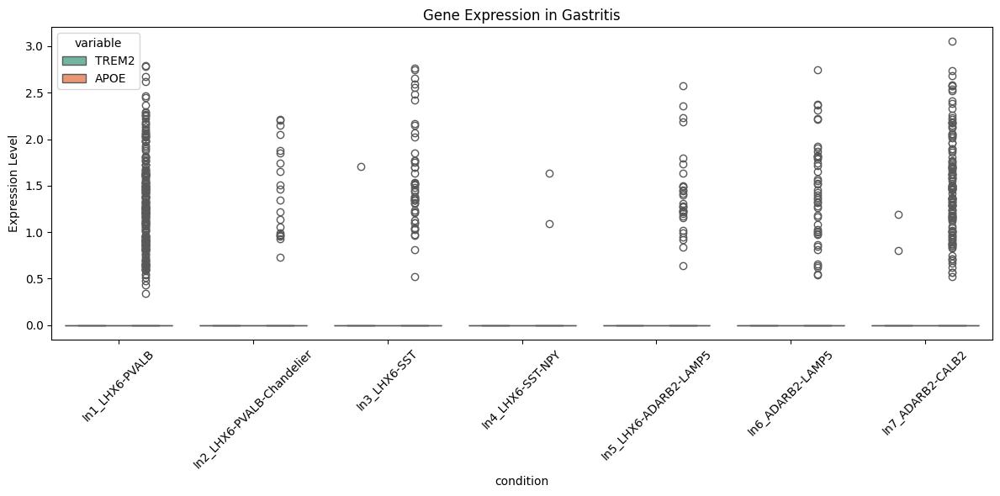

TREM2 - t-statistic: nan, p-value: nan
APOE - t-statistic: nan, p-value: nan

Analyzing Alzheimer's dataset:


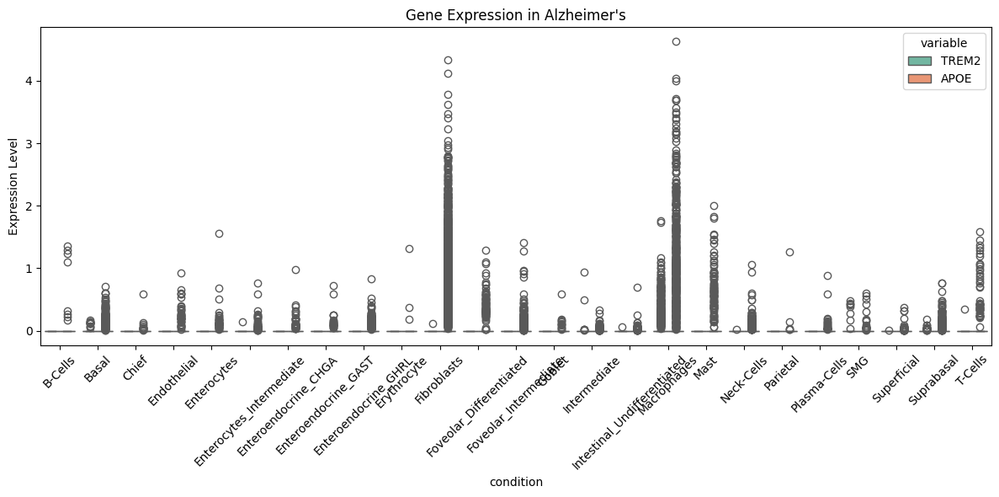

TREM2 - t-statistic: nan, p-value: nan
APOE - t-statistic: nan, p-value: nan


In [ ]:
# Function to extract gene expression data
def extract_gene_expression(adata, genes, condition_column):
    gene_data = pd.DataFrame(adata[:, list(genes.values())].X.toarray(), columns=list(genes.keys()))
    gene_data['condition'] = adata.obs[condition_column].values
    return gene_data

# Function to visualize gene expression
def visualize_gene_expression(data, title):
    plt.figure(figsize=(12, 6))
    sns.boxplot(x='condition', y='value', hue='variable', data=pd.melt(data, id_vars=['condition']))
    plt.title(title)
    plt.ylabel('Expression Level')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Function to perform statistical test
def perform_statistical_test(data, gene):
    normal = data[data['condition'] == 'Normal'][gene]
    sick = data[data['condition'] != 'Normal'][gene]
    t_stat, p_value = stats.ttest_ind(normal, sick)
    return t_stat, p_value

# Analyze Gastritis dataset
print("Analyzing Gastritis dataset:")
gastritis_gene_data = extract_gene_expression(gastritis_data, genes_of_interest, 'Cell.Types')
visualize_gene_expression(gastritis_gene_data, 'Gene Expression in Gastritis')

for gene in genes_of_interest.keys():
    t_stat, p_value = perform_statistical_test(gastritis_gene_data, gene)
    print(f"{gene} - t-statistic: {t_stat}, p-value: {p_value}")

# Analyze Alzheimer's dataset
print("\nAnalyzing Alzheimer's dataset:")
alzheimers_gene_data = extract_gene_expression(alzheimers_data, genes_of_interest, 'Celltypes_global')
visualize_gene_expression(alzheimers_gene_data, 'Gene Expression in Alzheimer\'s')

for gene in genes_of_interest.keys():
    t_stat, p_value = perform_statistical_test(alzheimers_gene_data, gene)
    print(f"{gene} - t-statistic: {t_stat}, p-value: {p_value}")


Comparing APOE and TREM2 expression in Gastritis:


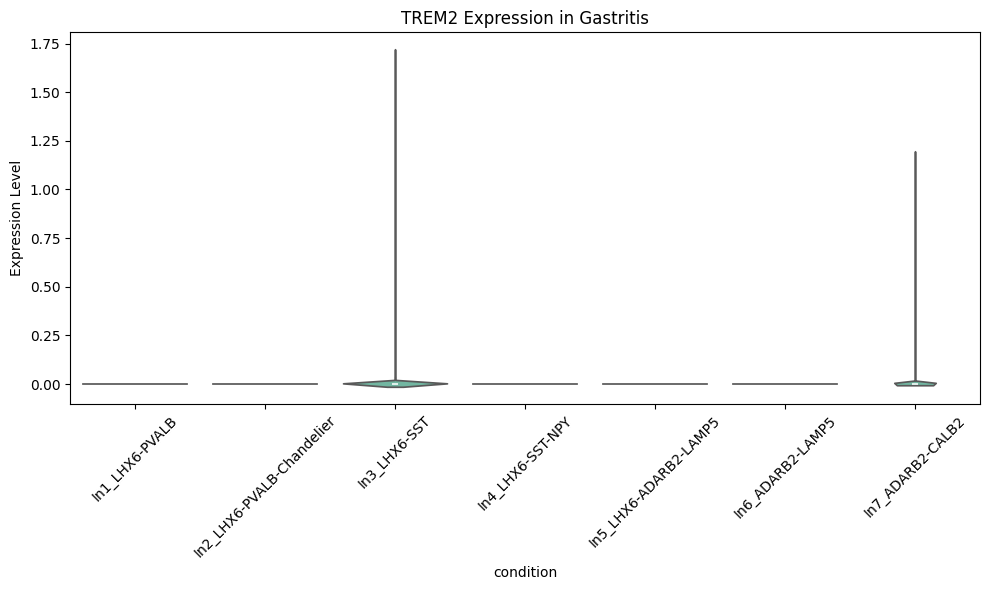

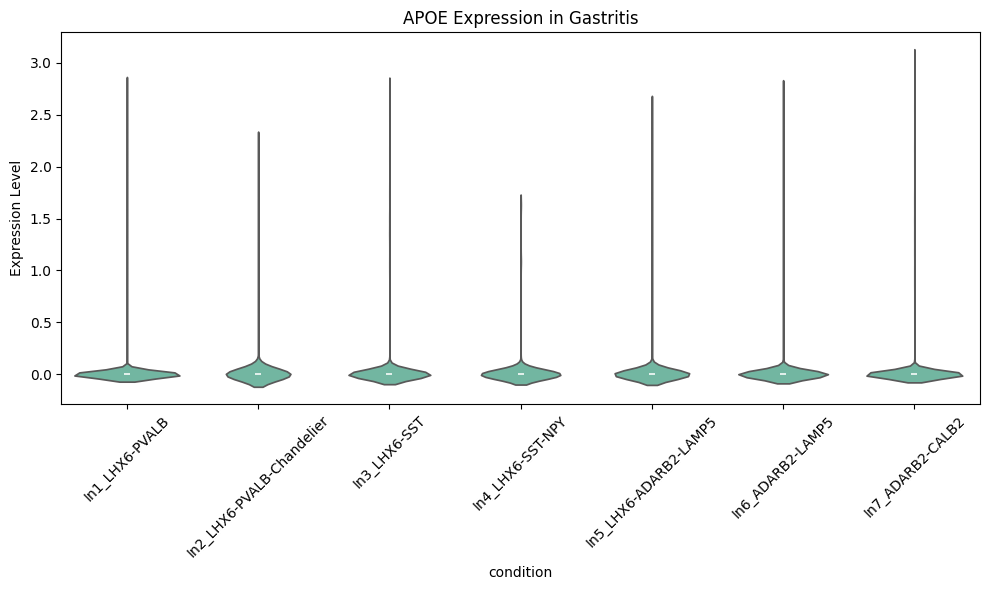


Comparing APOE and TREM2 expression in Alzheimer's:


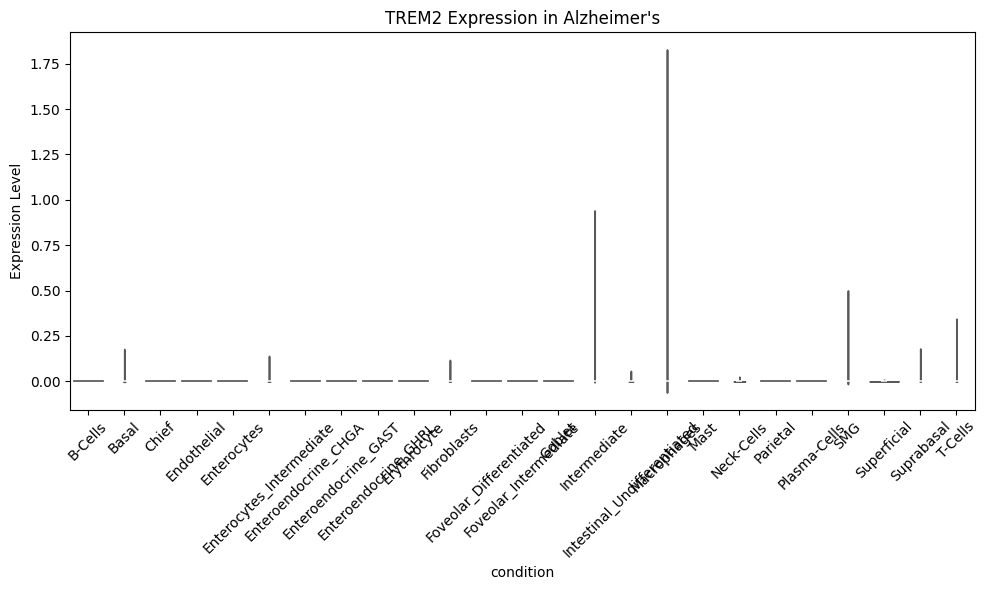

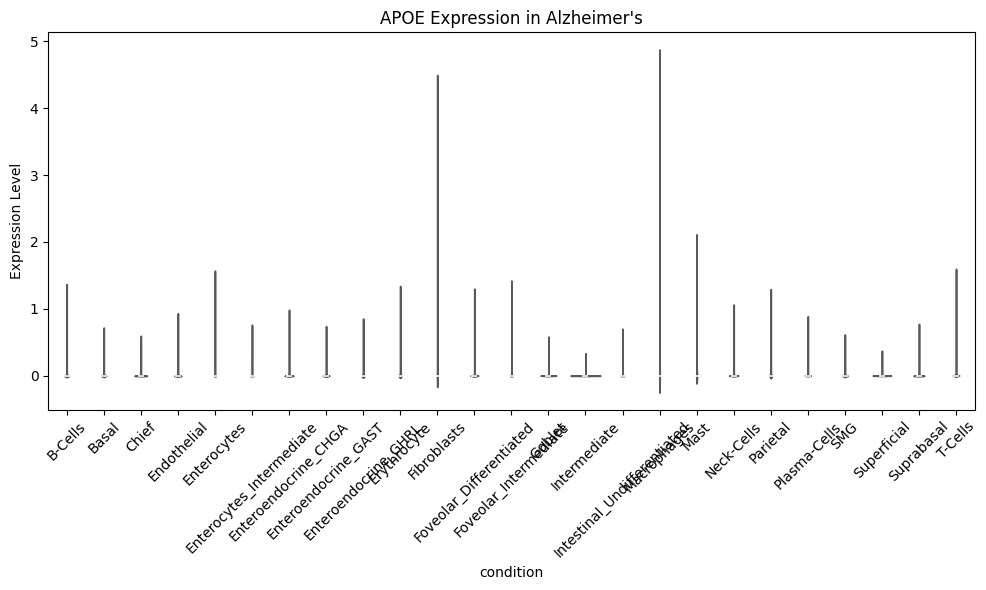

In [ ]:
# Function to compare gene expression between normal and sick individuals
def compare_gene_expression(data, gene, disease):
    plt.figure(figsize=(10, 6))
    sns.violinplot(x='condition', y=gene, data=data)
    plt.title(f'{gene} Expression in {disease}')
    plt.ylabel('Expression Level')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Compare APOE and TREM2 expression in Gastritis
print("\nComparing APOE and TREM2 expression in Gastritis:")
for gene in genes_of_interest.keys():
    compare_gene_expression(gastritis_gene_data, gene, 'Gastritis')

# Compare APOE and TREM2 expression in Alzheimer's
print("\nComparing APOE and TREM2 expression in Alzheimer's:")
for gene in genes_of_interest.keys():
    compare_gene_expression(alzheimers_gene_data, gene, 'Alzheimer\'s')

Analyzing Gastritis dataset:


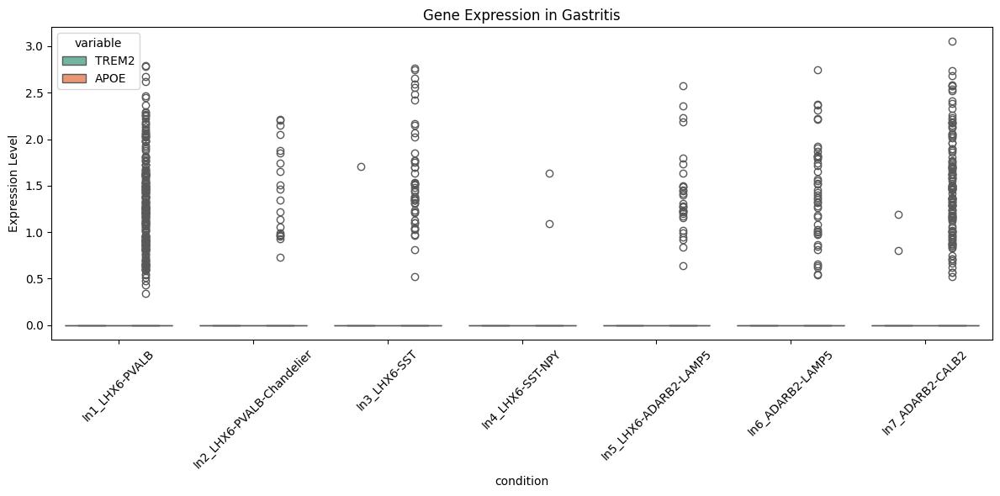

TREM2 - t-statistic: 0.8643029924038782, p-value: 0.38744464799668465
APOE - t-statistic: 0.5820802640979468, p-value: 0.5605272911343098

Comparing APOE and TREM2 expression in Gastritis:


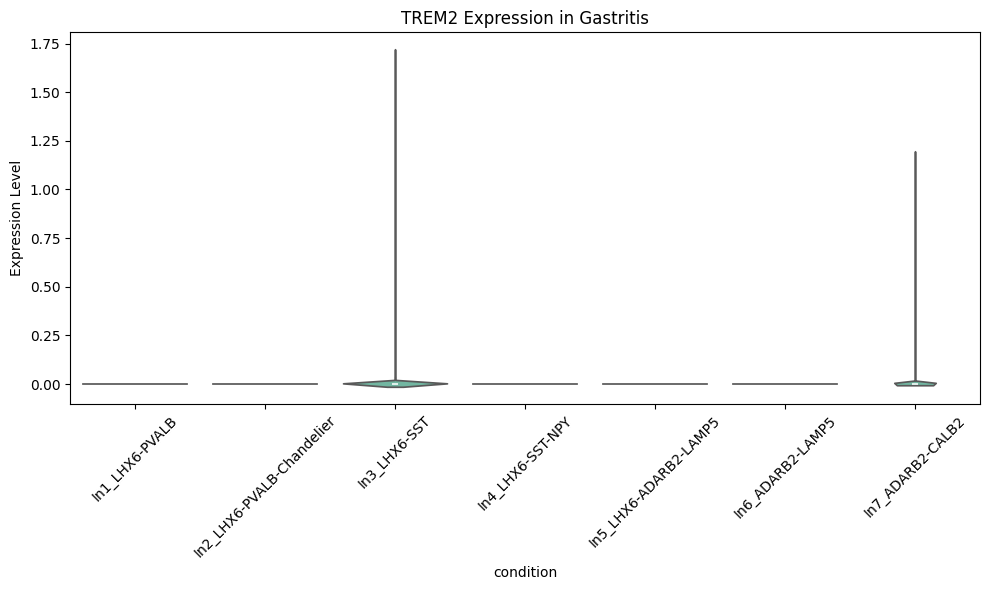

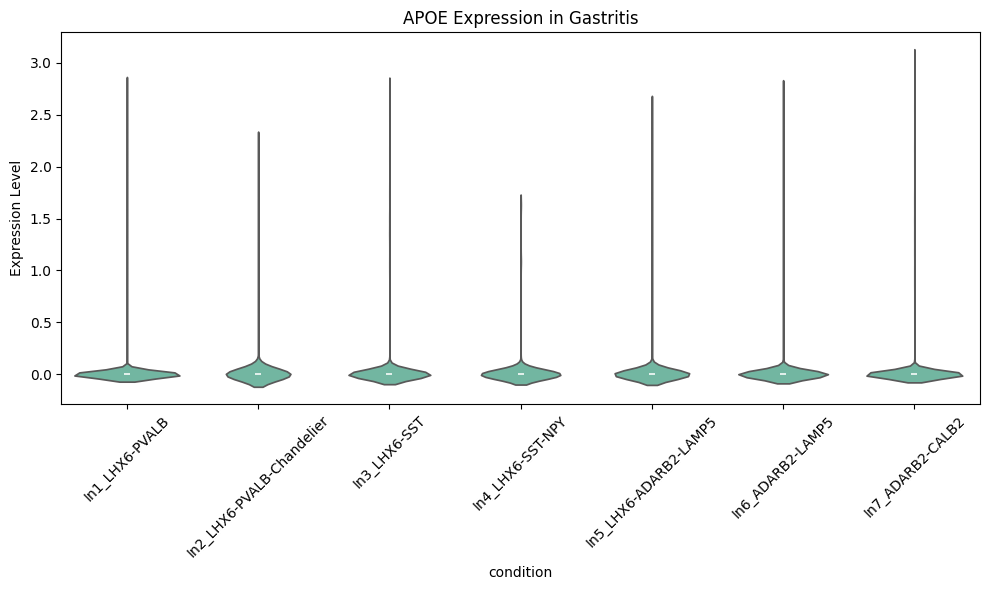


Analyzing Alzheimer's dataset:


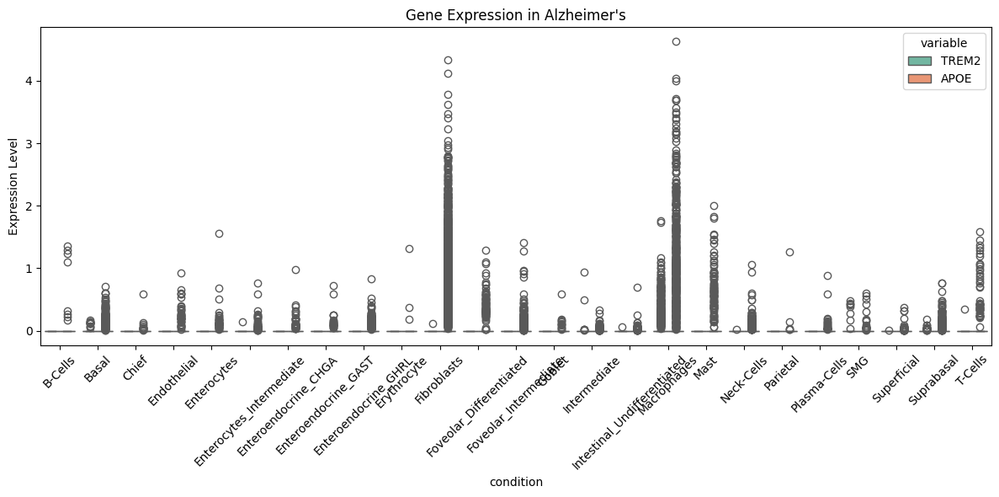

TREM2 - t-statistic: -1.537227795455086, p-value: 0.12425779364866586
APOE - t-statistic: -3.1931966798028437, p-value: 0.0014098611521115286

Comparing APOE and TREM2 expression in Alzheimer's:


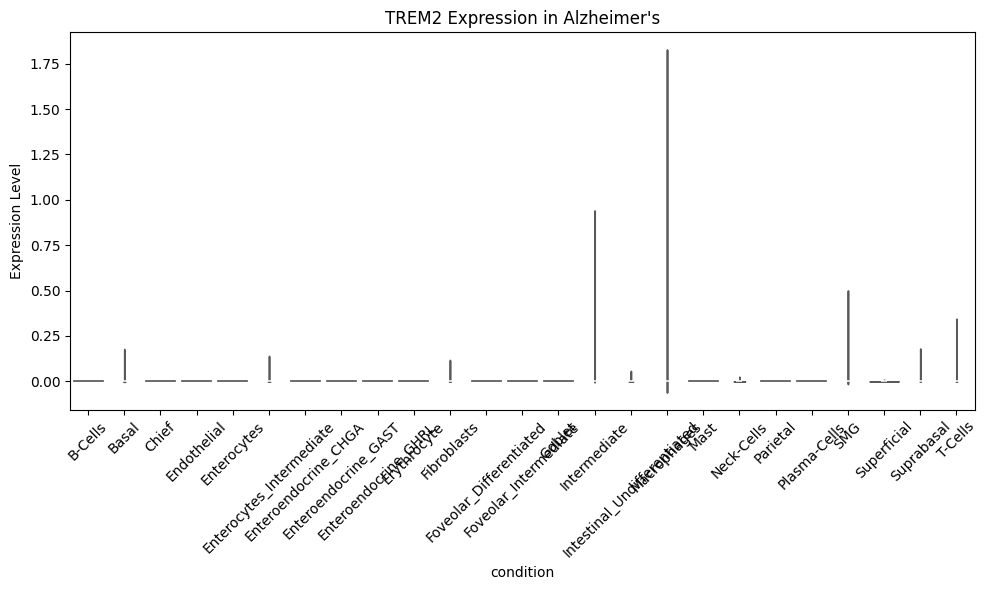

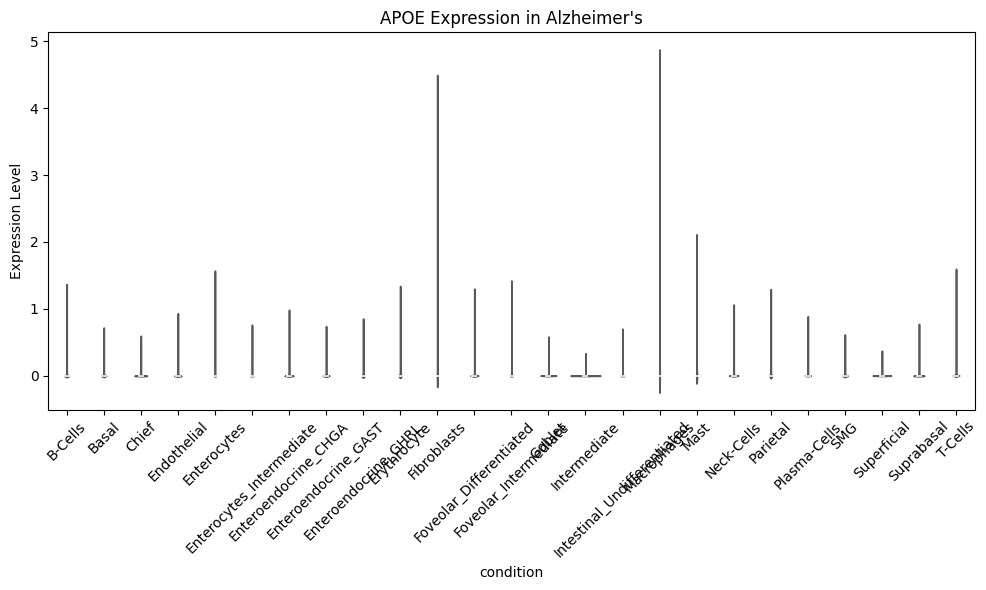


Comparing gene expression across all conditions:


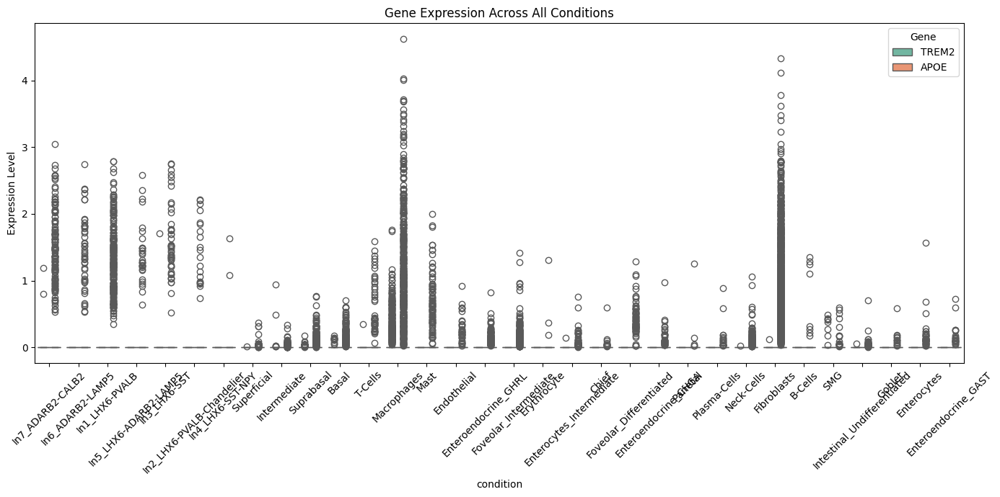

In [ ]:
# Function to extract gene expression data
def extract_gene_expression(adata, genes, condition_column):
    gene_data = pd.DataFrame(adata[:, list(genes.values())].X.toarray(), columns=list(genes.keys()))
    gene_data['condition'] = adata.obs[condition_column].values
    return gene_data

# Function to visualize gene expression
def visualize_gene_expression(data, title):
    plt.figure(figsize=(12, 6))
    sns.boxplot(x='condition', y='value', hue='variable', data=pd.melt(data, id_vars=['condition']))
    plt.title(title)
    plt.ylabel('Expression Level')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Function to perform statistical test
def perform_statistical_test(data, gene):
    conditions = data['condition'].unique()
    if len(conditions) < 2:
        print(f"Not enough conditions to perform statistical test for {gene}")
        return None, None

    condition1 = conditions[0]
    condition2 = conditions[1]
    group1 = data[data['condition'] == condition1][gene]
    group2 = data[data['condition'] == condition2][gene]

    t_stat, p_value = stats.ttest_ind(group1, group2)
    return t_stat, p_value

# Function to compare gene expression between conditions
def compare_gene_expression(data, gene, disease):
    plt.figure(figsize=(10, 6))
    sns.violinplot(x='condition', y=gene, data=data)
    plt.title(f'{gene} Expression in {disease}')
    plt.ylabel('Expression Level')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Analyze Gastritis dataset
print("Analyzing Gastritis dataset:")
gastritis_gene_data = extract_gene_expression(gastritis_data, genes_of_interest, 'Cell.Types')
visualize_gene_expression(gastritis_gene_data, 'Gene Expression in Gastritis')

for gene in genes_of_interest.keys():
    t_stat, p_value = perform_statistical_test(gastritis_gene_data, gene)
    if t_stat is not None and p_value is not None:
        print(f"{gene} - t-statistic: {t_stat}, p-value: {p_value}")

# Compare APOE and TREM2 expression in Gastritis
print("\nComparing APOE and TREM2 expression in Gastritis:")
for gene in genes_of_interest.keys():
    compare_gene_expression(gastritis_gene_data, gene, 'Gastritis')

# Analyze Alzheimer's dataset
print("\nAnalyzing Alzheimer's dataset:")
alzheimers_gene_data = extract_gene_expression(alzheimers_data, genes_of_interest, 'Celltypes_global')
visualize_gene_expression(alzheimers_gene_data, 'Gene Expression in Alzheimer\'s')

for gene in genes_of_interest.keys():
    t_stat, p_value = perform_statistical_test(alzheimers_gene_data, gene)
    if t_stat is not None and p_value is not None:
        print(f"{gene} - t-statistic: {t_stat}, p-value: {p_value}")

# Compare APOE and TREM2 expression in Alzheimer's
print("\nComparing APOE and TREM2 expression in Alzheimer's:")
for gene in genes_of_interest.keys():
    compare_gene_expression(alzheimers_gene_data, gene, 'Alzheimer\'s')

# Additional analysis: Compare gene expression across all conditions
print("\nComparing gene expression across all conditions:")
combined_data = pd.concat([gastritis_gene_data, alzheimers_gene_data], keys=['Gastritis', 'Alzheimer\'s'])
combined_data.reset_index(level=0, inplace=True)
combined_data.rename(columns={'level_0': 'dataset'}, inplace=True)

plt.figure(figsize=(14, 7))
sns.boxplot(x='condition', y='value', hue='variable', data=pd.melt(combined_data, id_vars=['condition', 'dataset']), dodge=True)
plt.title('Gene Expression Across All Conditions')
plt.ylabel('Expression Level')
plt.xticks(rotation=45)
plt.legend(title='Gene')
plt.tight_layout()
plt.show()


In [ ]:
# Perform ANOVA to compare gene expression across all conditions
for gene in genes_of_interest.keys():
    f_stat, p_value = stats.f_oneway(*[group[gene].values for name, group in combined_data.groupby('condition')])
    print(f"ANOVA results for {gene}: F-statistic = {f_stat}, p-value = {p_value}")

ANOVA results for TREM2: F-statistic = 312.75778946188365, p-value = 0.0
ANOVA results for APOE: F-statistic = 480.072550974488, p-value = 0.0


Analyzing Gastritis dataset:

Analysis for TREM2 gene:


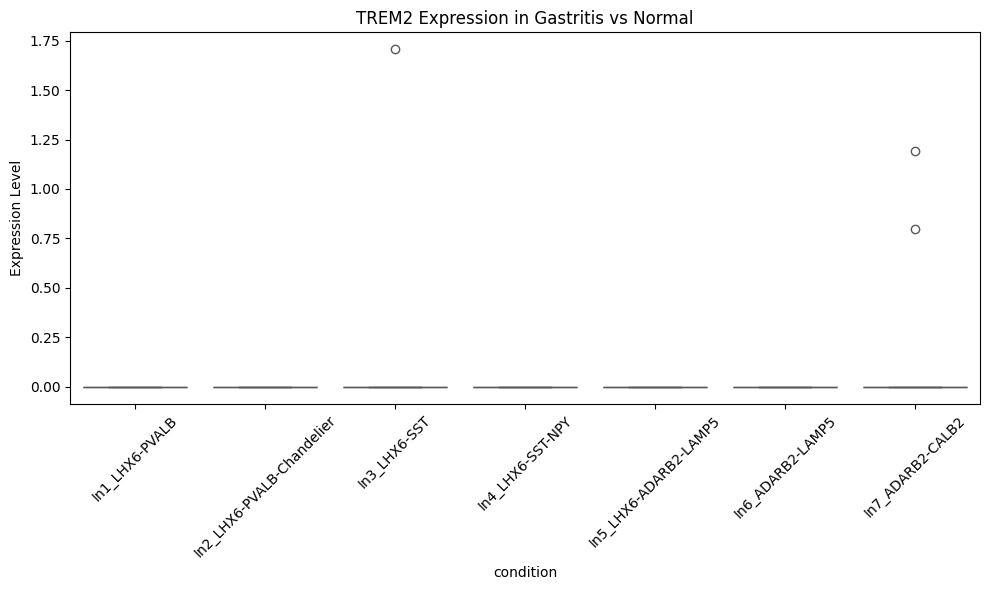

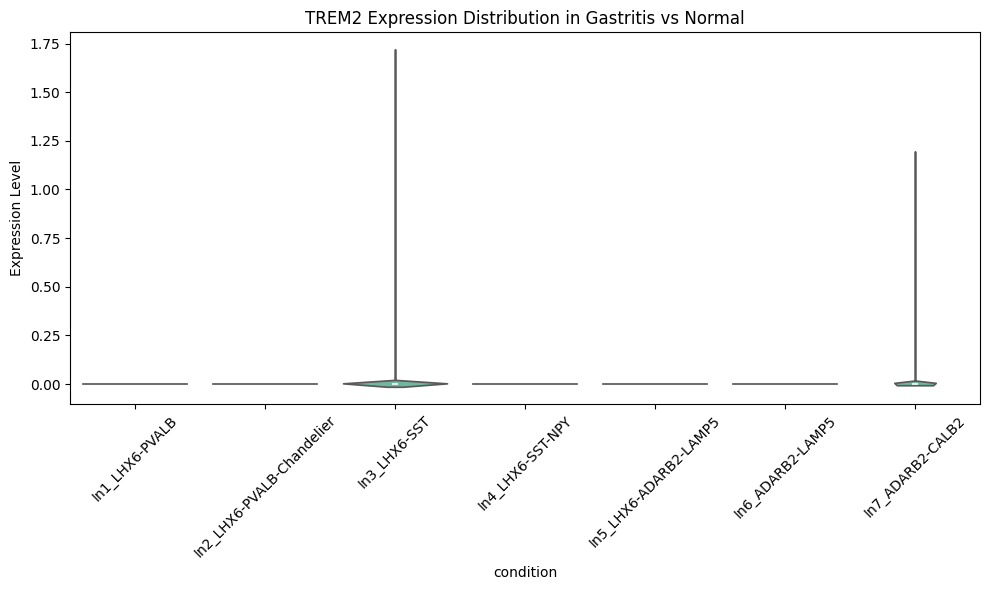

T-statistic: nan, p-value: nan

Analysis for APOE gene:


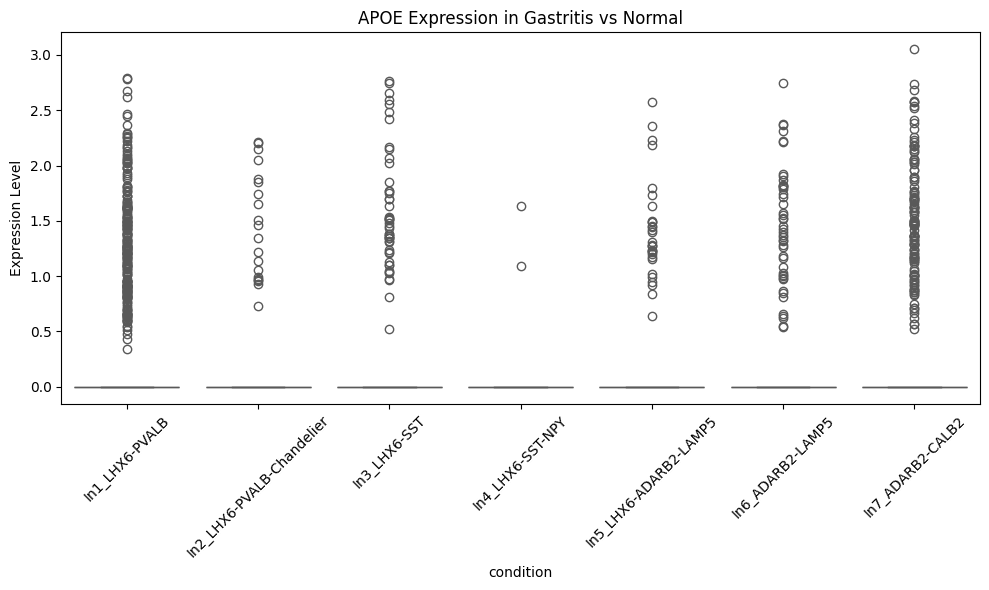

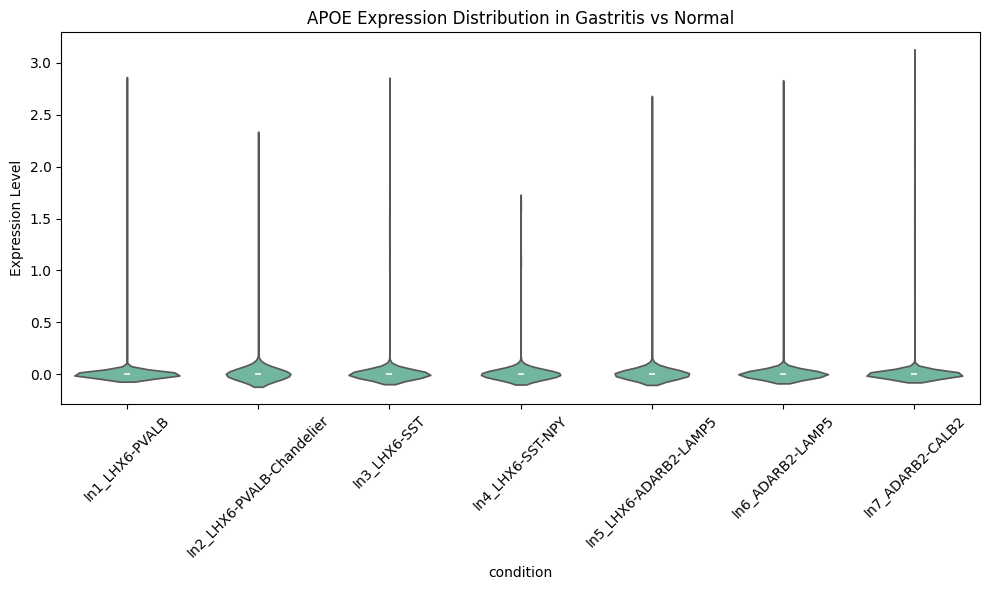

T-statistic: nan, p-value: nan

Analyzing Alzheimer's dataset:

Analysis for TREM2 gene:


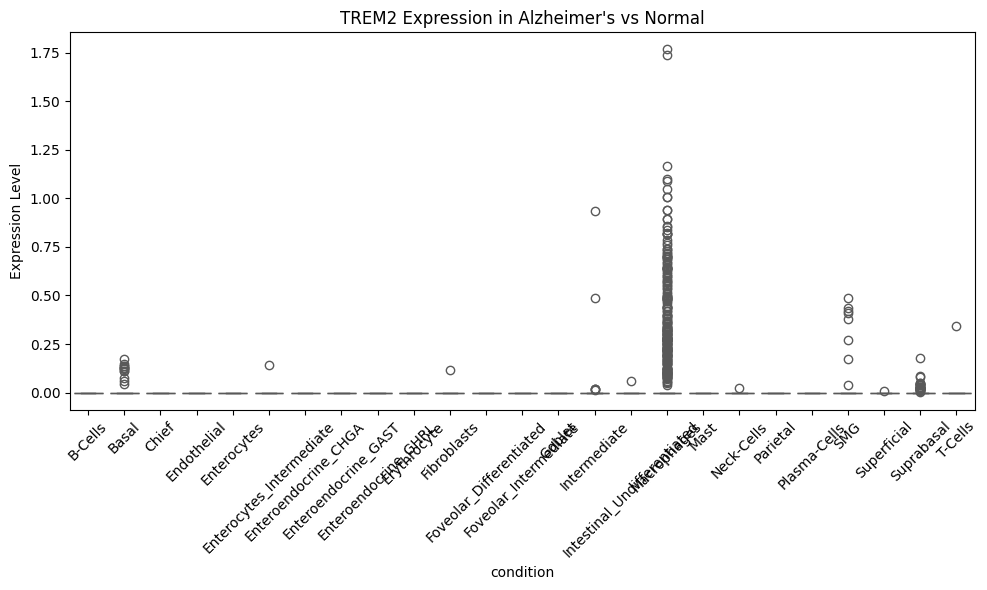

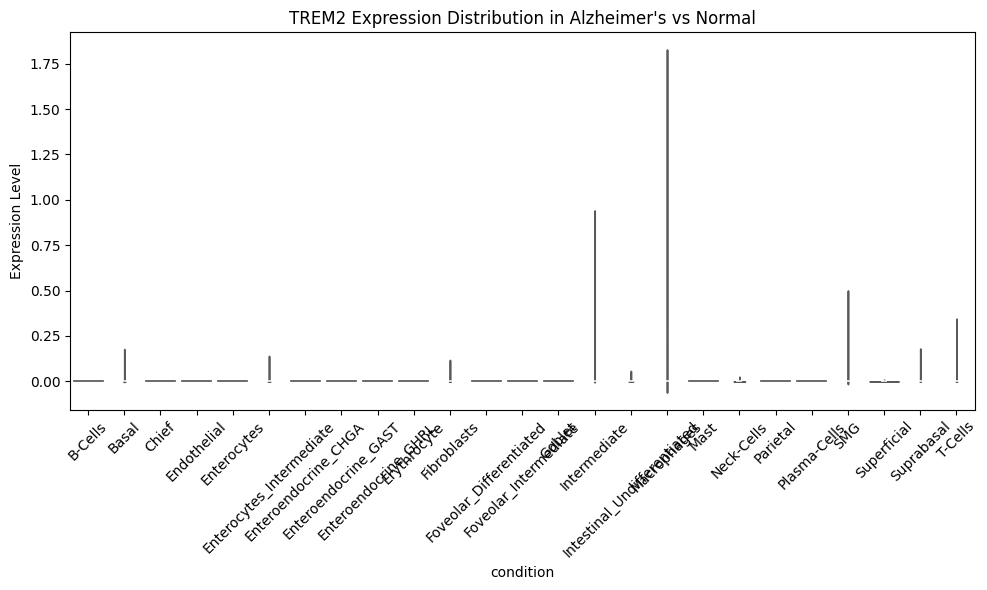

T-statistic: nan, p-value: nan

Analysis for APOE gene:


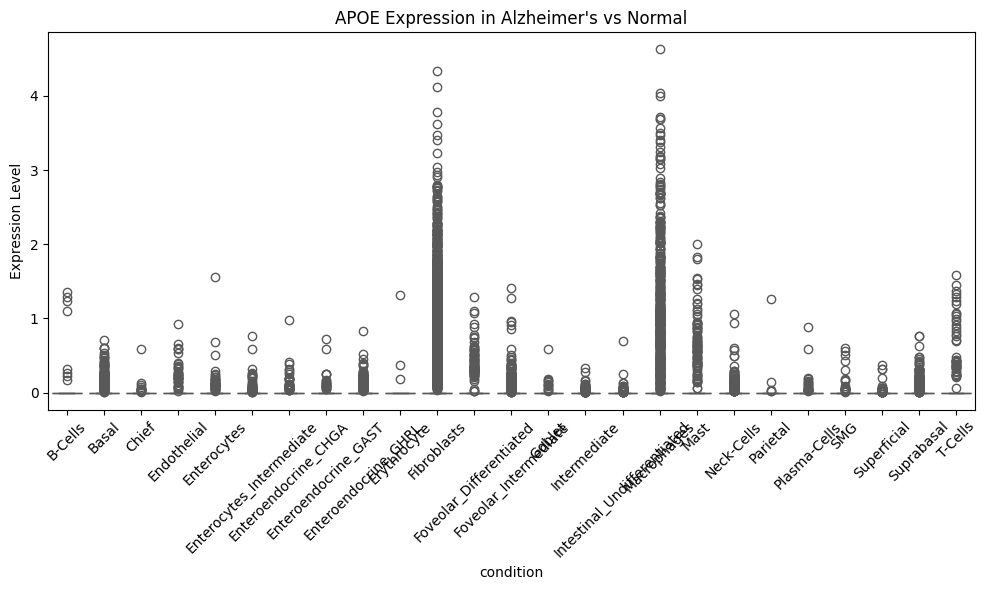

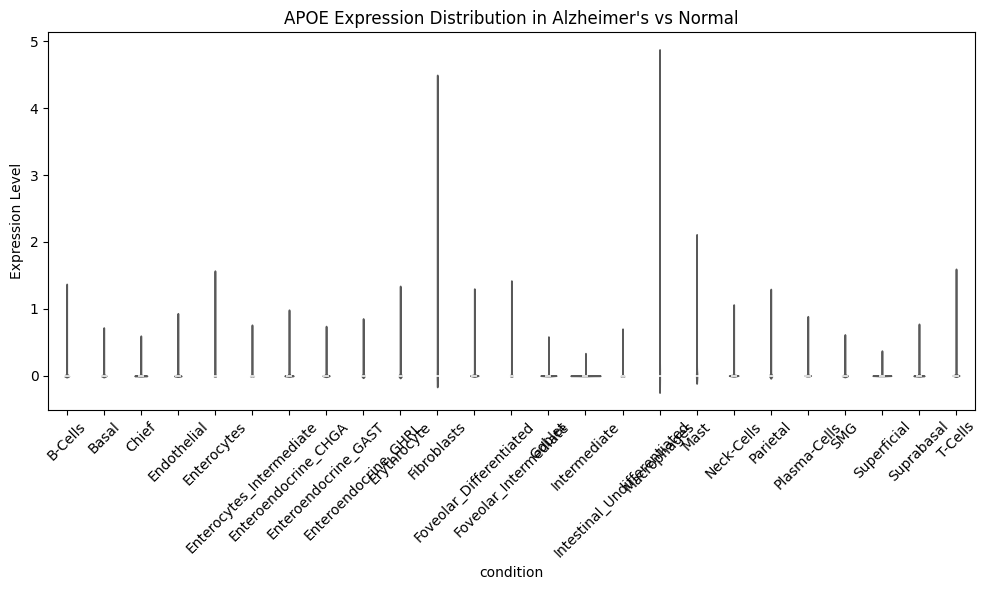

T-statistic: nan, p-value: nan


In [ ]:
# Function to extract gene expression data
def extract_gene_expression(adata, genes, condition_column):
    gene_data = pd.DataFrame(adata[:, list(genes.values())].X.toarray(), columns=list(genes.keys()))
    gene_data['condition'] = adata.obs[condition_column].values
    return gene_data

# Extract gene data
gastritis_gene_data = extract_gene_expression(gastritis_data, genes_of_interest, 'Cell.Types')
alzheimers_gene_data = extract_gene_expression(alzheimers_data, genes_of_interest, 'Celltypes_global')

# Function to perform statistical test
def perform_statistical_test(data, gene, condition1, condition2):
    group1 = data[data['condition'] == condition1][gene]
    group2 = data[data['condition'] == condition2][gene]
    t_stat, p_value = stats.ttest_ind(group1, group2)
    return t_stat, p_value

# Function to create boxplot
def create_boxplot(data, gene, title):
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='condition', y=gene, data=data)
    plt.title(title)
    plt.ylabel('Expression Level')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Function to create violin plot
def create_violin_plot(data, gene, title):
    plt.figure(figsize=(10, 6))
    sns.violinplot(x='condition', y=gene, data=data)
    plt.title(title)
    plt.ylabel('Expression Level')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Analyze Gastritis dataset
print("Analyzing Gastritis dataset:")
for gene in genes_of_interest.keys():
    print(f"\nAnalysis for {gene} gene:")
    create_boxplot(gastritis_gene_data, gene, f'{gene} Expression in Gastritis vs Normal')
    create_violin_plot(gastritis_gene_data, gene, f'{gene} Expression Distribution in Gastritis vs Normal')

    t_stat, p_value = perform_statistical_test(gastritis_gene_data, gene, 'Normal', 'Gastritis')
    print(f"T-statistic: {t_stat}, p-value: {p_value}")

# Analyze Alzheimer's dataset
print("\nAnalyzing Alzheimer's dataset:")
for gene in genes_of_interest.keys():
    print(f"\nAnalysis for {gene} gene:")
    create_boxplot(alzheimers_gene_data, gene, f'{gene} Expression in Alzheimer\'s vs Normal')
    create_violin_plot(alzheimers_gene_data, gene, f'{gene} Expression Distribution in Alzheimer\'s vs Normal')

    t_stat, p_value = perform_statistical_test(alzheimers_gene_data, gene, 'Normal', 'Alzheimer\'s')
    print(f"T-statistic: {t_stat}, p-value: {p_value}")

# Function to create a complex heatmap
def create_complex_heatmap(data, title):
    plt.figure(figsize=(12, 8))
    correlation = data[list(genes_of_interest.keys())].corr()
    mask = np.triu(np.ones_like(correlation, dtype=bool))
    cmap = sns.diverging_palette(220, 10, as_cmap=True)
    sns.heatmap(correlation, mask=mask, cmap=cmap, vmax=.3, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5})
    plt.title(title)
    plt.tight_layout()
    plt.show()

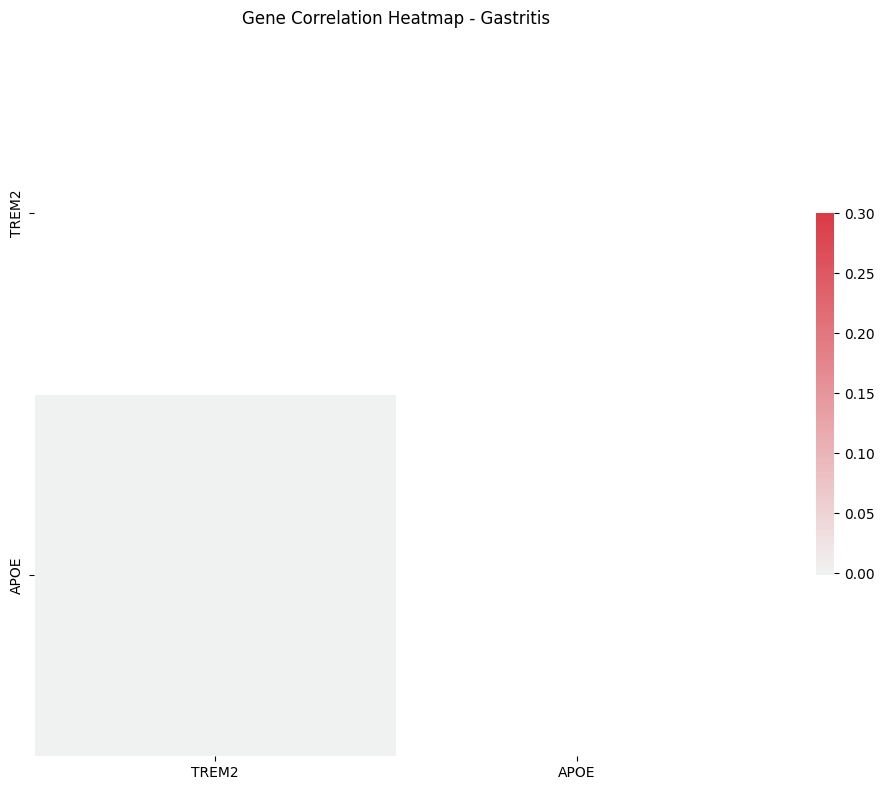

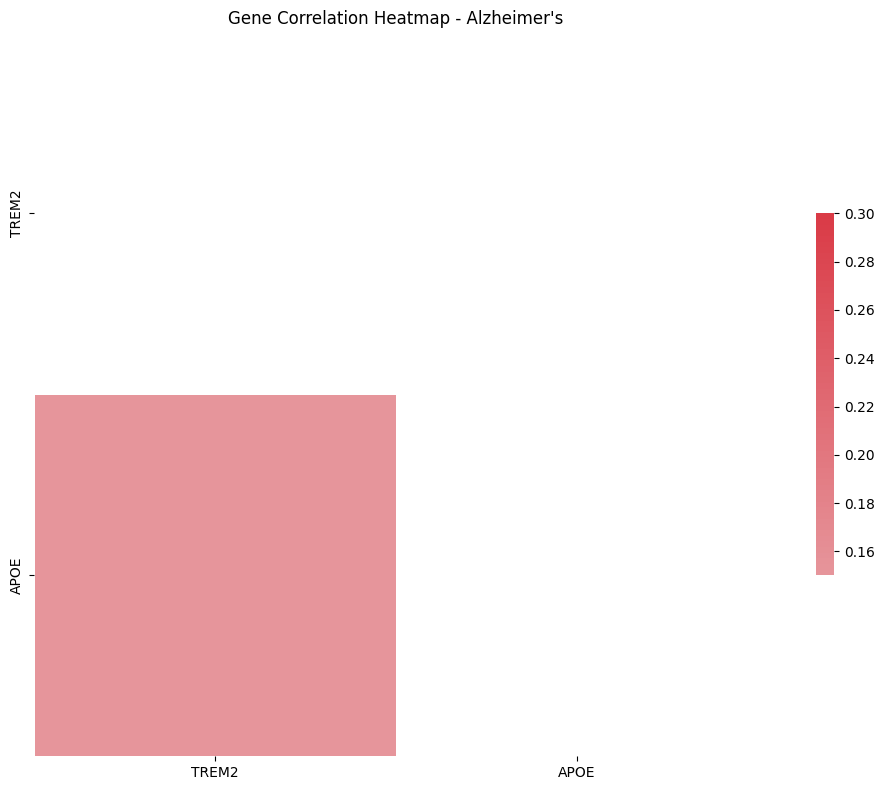

In [ ]:
# Create complex heatmaps
create_complex_heatmap(gastritis_gene_data, 'Gene Correlation Heatmap - Gastritis')
create_complex_heatmap(alzheimers_gene_data, 'Gene Correlation Heatmap - Alzheimer\'s')

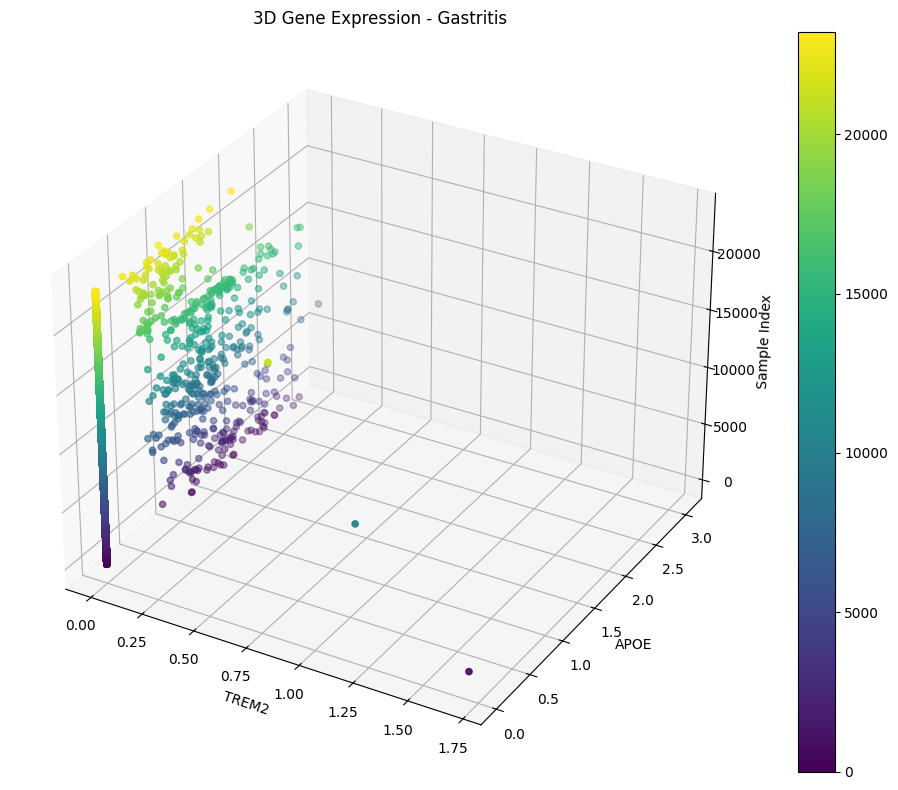

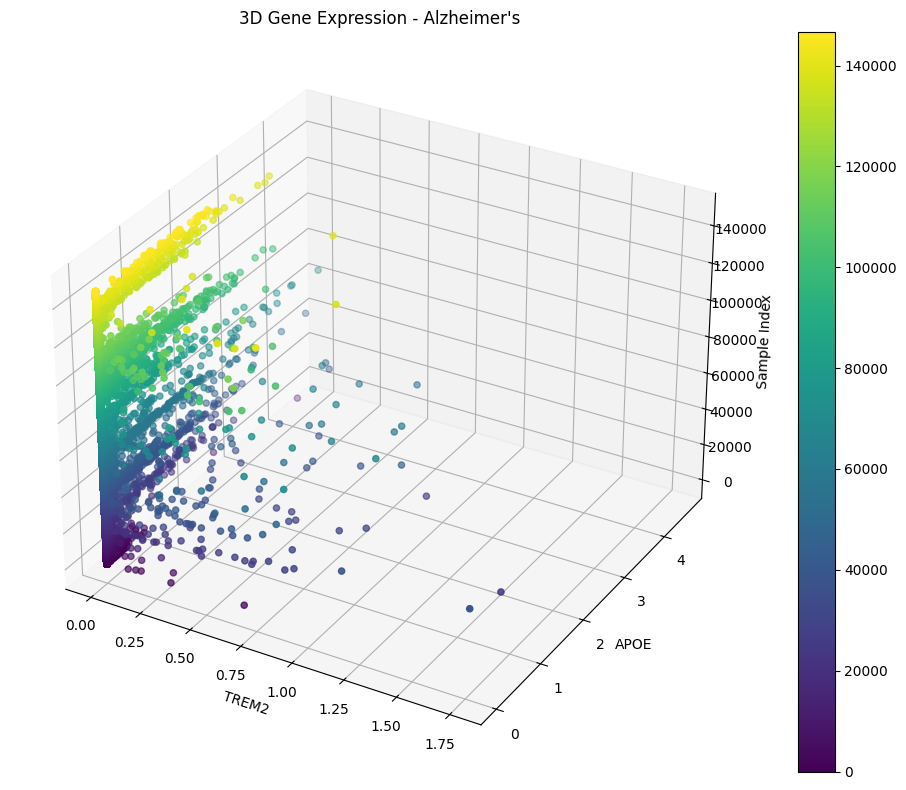

In [ ]:
# Function to create a 3D scatter plot
def create_3d_scatter(data, title):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(data['TREM2'], data['APOE'], data.index,
                         c=data.index, cmap='viridis')
    ax.set_xlabel('TREM2')
    ax.set_ylabel('APOE')
    ax.set_zlabel('Sample Index')
    plt.colorbar(scatter)
    plt.title(title)
    plt.tight_layout()
    plt.show()

# Create 3D scatter plots
create_3d_scatter(gastritis_gene_data, '3D Gene Expression - Gastritis')
create_3d_scatter(alzheimers_gene_data, '3D Gene Expression - Alzheimer\'s')

In [ ]:
# Function to create an interactive scatter plot using Plotly
def create_interactive_scatter(data, title):
    fig = px.scatter(data, x='TREM2', y='APOE', color='condition',
                     hover_data=['condition'], title=title)
    fig.show()

# Create interactive scatter plots
create_interactive_scatter(gastritis_gene_data, 'Interactive Gene Expression - Gastritis')
create_interactive_scatter(alzheimers_gene_data, 'Interactive Gene Expression - Alzheimer\'s')

In [ ]:
# Combine datasets for ML analysis
gastritis_gene_data['dataset'] = 'Gastritis'
alzheimers_gene_data['dataset'] = 'Alzheimer\'s'
combined_data = pd.concat([gastritis_gene_data, alzheimers_gene_data], ignore_index=True)

# Prepare data for ML
X = combined_data[list(genes_of_interest.keys())]
y = combined_data['dataset']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define and train the models
models = {
    'Random Forest': RandomForestClassifier(n_estimators=100, random_state=42),
    'SVM': SVC(kernel='rbf', random_state=42),
    'Logistic Regression': LogisticRegression(random_state=42)
}

results = {}

for name, model in models.items():
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)
    accuracy = accuracy_score(y_test, y_pred)
    results[name] = {
        'accuracy': accuracy,
        'classification_report': classification_report(y_test, y_pred),
        'confusion_matrix': confusion_matrix(y_test, y_pred)
    }

# Print results
for name, result in results.items():
    print(f"\n{name} Results:")
    print(f"Accuracy: {result['accuracy']}")
    print("Classification Report:")
    print(result['classification_report'])
    print("Confusion Matrix:")
    print(result['confusion_matrix'])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.




Random Forest Results:
Accuracy: 0.8667982094475203
Classification Report:
              precision    recall  f1-score   support

 Alzheimer's       0.87      1.00      0.93     29453
   Gastritis       0.37      0.01      0.01      4503

    accuracy                           0.87     33956
   macro avg       0.62      0.50      0.47     33956
weighted avg       0.80      0.87      0.81     33956

Confusion Matrix:
[[29404    49]
 [ 4474    29]]

SVM Results:
Accuracy: 0.8673872069737307
Classification Report:
              precision    recall  f1-score   support

 Alzheimer's       0.87      1.00      0.93     29453
   Gastritis       0.00      0.00      0.00      4503

    accuracy                           0.87     33956
   macro avg       0.43      0.50      0.46     33956
weighted avg       0.75      0.87      0.81     33956

Confusion Matrix:
[[29453     0]
 [ 4503     0]]

Logistic Regression Results:
Accuracy: 0.8672105077158676
Classification Report:
              precision 

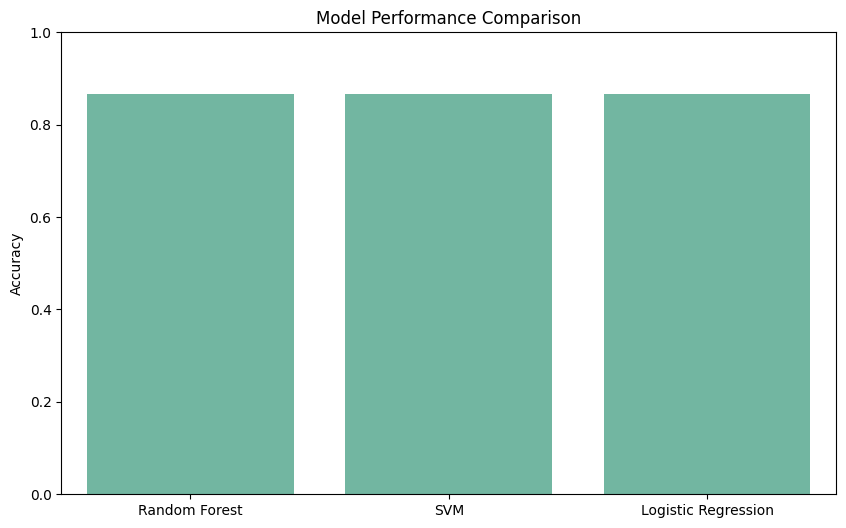

In [ ]:
# Visualize model performance
plt.figure(figsize=(10, 6))
sns.barplot(x=list(results.keys()), y=[result['accuracy'] for result in results.values()])
plt.title('Model Performance Comparison')
plt.ylabel('Accuracy')
plt.ylim(0, 1)
plt.show()

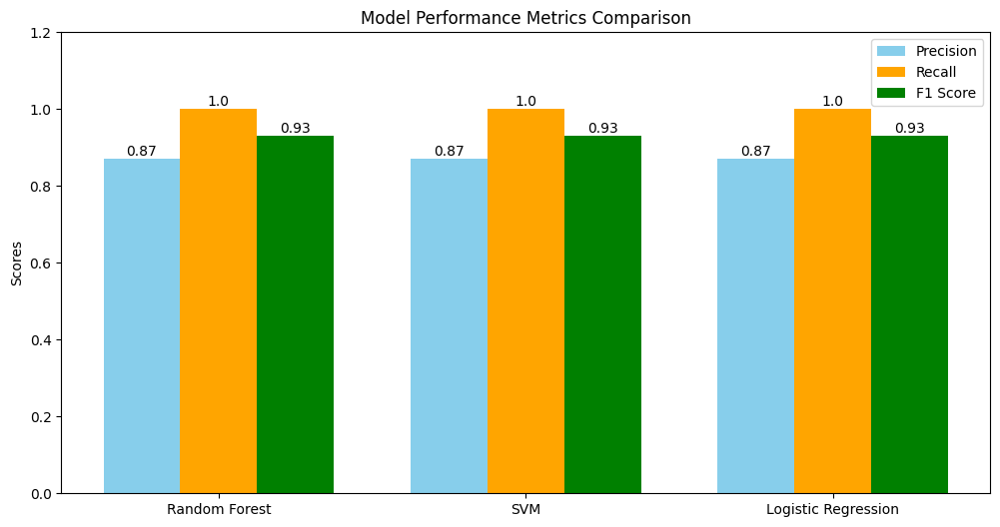

In [ ]:
# Model results
results = {
    'Random Forest': {
        'precision': 0.87, 'recall': 1.00, 'f1-score': 0.93
    },
    'SVM': {
        'precision': 0.87, 'recall': 1.00, 'f1-score': 0.93,
    },
    'Logistic Regression': {
        'precision': 0.87, 'recall': 1.00, 'f1-score': 0.93,
    }
}

# Preparing data for plotting
model_names = list(results.keys())
precision = [result['precision'] for result in results.values()]
recall = [result['recall'] for result in results.values()]
f1_score = [result['f1-score'] for result in results.values()]

# Creating a grouped bar plot
x = np.arange(len(model_names))  # the label locations
width = 0.25  # the width of the bars

fig, ax = plt.subplots(figsize=(12, 6))

# Adding bars for each metric
bars1 = ax.bar(x - width, precision, width, label='Precision', color='skyblue')
bars2 = ax.bar(x, recall, width, label='Recall', color='orange')
bars3 = ax.bar(x + width, f1_score, width, label='F1 Score', color='green')

# Adding labels and title
ax.set_ylabel('Scores')
ax.set_title('Model Performance Metrics Comparison')
ax.set_xticks(x)
ax.set_xticklabels(model_names)
ax.legend()

# Adding value labels on top of the bars
for bars in [bars1, bars2, bars3]:
    for bar in bars:
        yval = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2, yval, round(yval, 2),
                ha='center', va='bottom')

plt.ylim(0, 1.2)
plt.show()


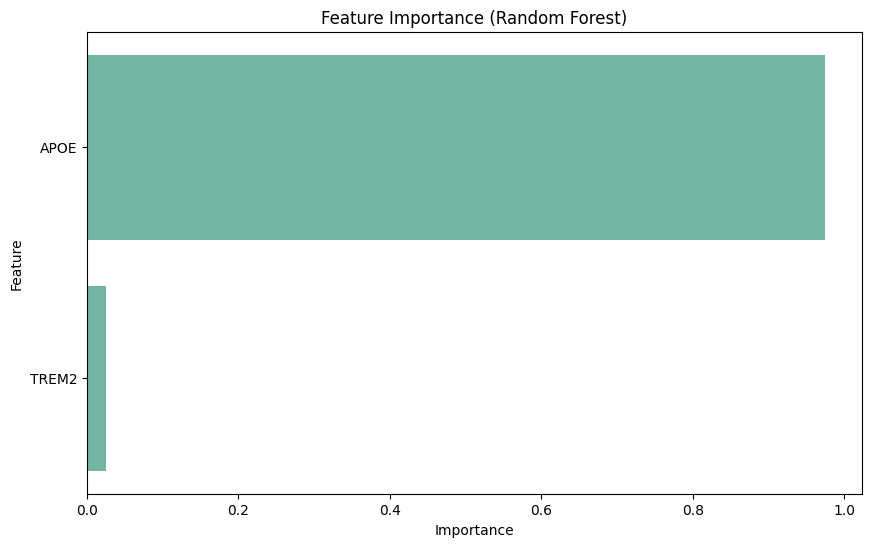

In [29]:
# Feature importance for Random Forest
rf_model = models['Random Forest']
feature_importance = pd.DataFrame({
    'feature': list(genes_of_interest.keys()),
    'importance': rf_model.feature_importances_
})
feature_importance = feature_importance.sort_values('importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='importance', y='feature', data=feature_importance)
plt.title('Feature Importance (Random Forest)')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

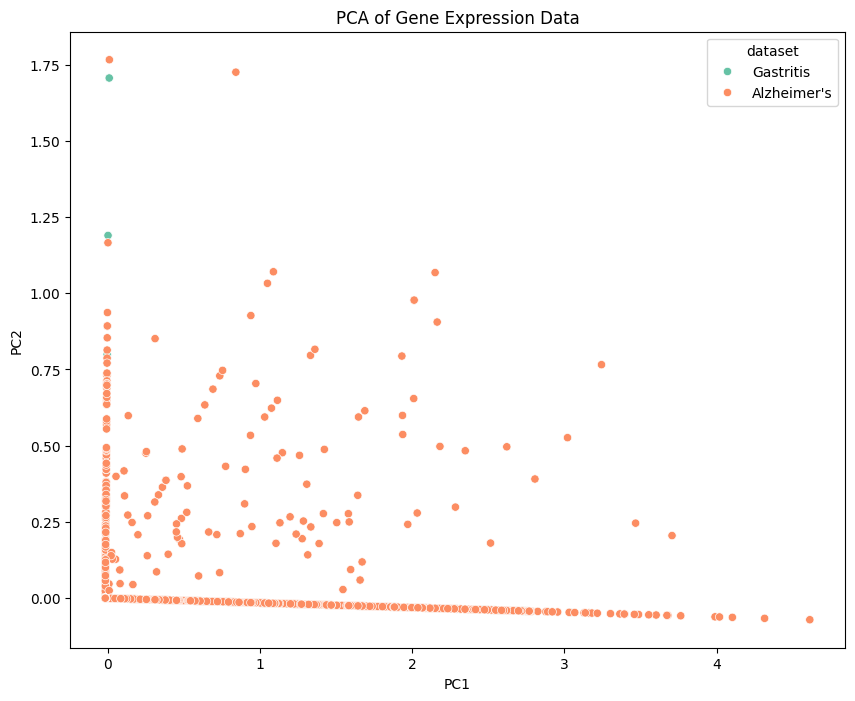

In [30]:
# PCA visualization
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)
pca_df = pd.DataFrame(data=X_pca, columns=['PC1', 'PC2'])
pca_df['dataset'] = y

plt.figure(figsize=(10, 8))
sns.scatterplot(x='PC1', y='PC2', hue='dataset', data=pca_df)
plt.title('PCA of Gene Expression Data')
plt.show()

In [31]:
# Interactive 3D PCA plot
fig = px.scatter_3d(
    pca_df, x='PC1', y='PC2', z=X['TREM2'],
    color='dataset', symbol='dataset',
    title='3D PCA Plot with TREM2 Expression'
)
fig.show()

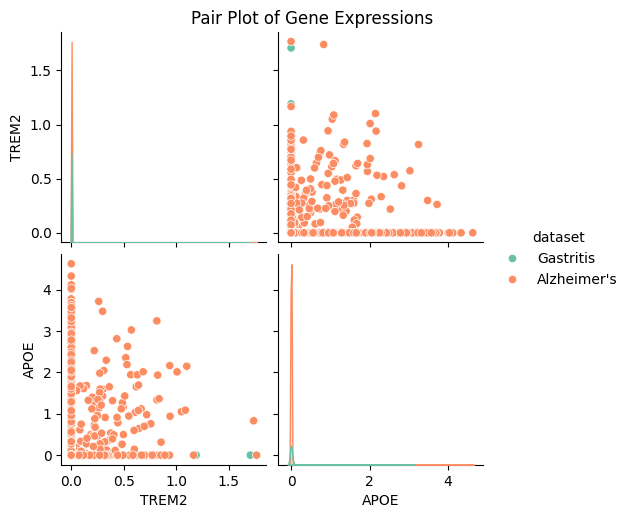

In [32]:
# Pair plot
sns.pairplot(combined_data, hue='dataset', vars=list(genes_of_interest.keys()))
plt.suptitle('Pair Plot of Gene Expressions', y=1.02)
plt.show()

In [33]:
print("Columns in Gastritis dataset:")
print(gastritis_data.obs.columns)

print("\nColumns in Alzheimer's dataset:")
print(alzheimers_data.obs.columns)

Columns in Gastritis dataset:
Index(['nCount_RNA', 'nFeature_RNA', 'percent.mt', 'SORT', 'Amyloid', 'Age',
       'RIN', 'nCount_SCT', 'nFeature_SCT', 'nCount_Exon', 'nFeature_Exon',
       'PMI', 'Braak', 'Sample.ID', 'Cell.Types', 'tissue_ontology_term_id',
       'assay_ontology_term_id', 'disease_ontology_term_id',
       'cell_type_ontology_term_id', 'development_stage_ontology_term_id',
       'self_reported_ethnicity_ontology_term_id', 'sex_ontology_term_id',
       'is_primary_data', 'organism_ontology_term_id', 'donor_id',
       'suspension_type', 'tissue_type', 'cell_type', 'assay', 'disease',
       'organism', 'sex', 'tissue', 'self_reported_ethnicity',
       'development_stage', 'observation_joinid'],
      dtype='object')

Columns in Alzheimer's dataset:
Index(['Sample', 'Tissue_in_paper', 'Batch', 'Sample_Barcode', 'sum',
       'detected', 'Study', 'Patient_type', 'Patient_status', 'MT.prop',
       'sizeFactor', 'Global_cluster_selected', 'Celltypes_global',
       '

In [34]:
# Define the genes of interest
genes_of_interest = {'TREM2': 'ENSG00000095970', 'APOE': 'ENSG00000130203'}

# Function to extract gene expression data
def extract_gene_expression(adata, genes, condition_column):
    gene_data = pd.DataFrame(adata[:, list(genes.values())].X.toarray(), columns=list(genes.keys()))
    gene_data['condition'] = adata.obs[condition_column].values
    return gene_data

# Extract gene data
gastritis_gene_data = extract_gene_expression(gastritis_data, genes_of_interest, 'Cell.Types')
alzheimers_gene_data = extract_gene_expression(alzheimers_data, genes_of_interest, 'Celltypes_global')

# Add age information
gastritis_gene_data['Age'] = gastritis_data.obs['Age'].values
alzheimers_gene_data['Age'] = alzheimers_data.obs['Patient_status'].values  # Using Patient_status as a proxy for age groups

# Check for NaN values in Age column
nan_values_gastritis = gastritis_gene_data['Age'].isna().sum()
print(f"Number of NaN values in Age column (Gastritis): {nan_values_gastritis}")

# Convert 'Age' to numeric and handle NaN values
gastritis_gene_data['Age'] = pd.to_numeric(gastritis_gene_data['Age'], errors='coerce')
gastritis_gene_data['Age'].fillna(gastritis_gene_data['Age'].median(), inplace=True)

Number of NaN values in Age column (Gastritis): 0


<ipython-input-34-1a6b11c906a2>:24: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [35]:
# Function to create age groups
def create_age_groups(data, num_groups=5):
    try:
        data['age_group'] = pd.qcut(data['Age'], q=num_groups, labels=[f'Group {i+1}' for i in range(num_groups)], duplicates='drop')
    except ValueError as e:
        print(f"Error creating age groups: {e}")
        # If qcut fails, use cut as a fallback
        data['age_group'] = pd.cut(data['Age'], bins=num_groups, labels=[f'Group {i+1}' for i in range(num_groups)])
    return data

# Create age groups for gastritis data
gastritis_gene_data = create_age_groups(gastritis_gene_data)

# For Alzheimer's data, use Patient_status as age groups
alzheimers_gene_data['age_group'] = alzheimers_gene_data['Age']

# Function to plot gene expression trends across age groups
def plot_gene_expression_trend(data, gene, title):
    plt.figure(figsize=(12, 6))
    sns.boxplot(x='age_group', y=gene, data=data, hue='condition')
    plt.title(f'{title} - {gene} Expression Across Age Groups')
    plt.xlabel('Age Group')
    plt.ylabel('Expression Level')
    plt.legend(title='Condition')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


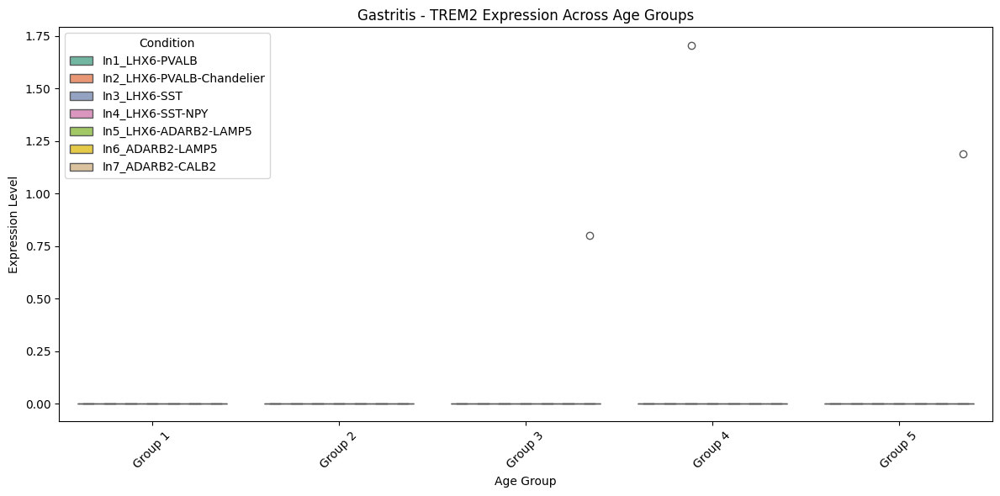

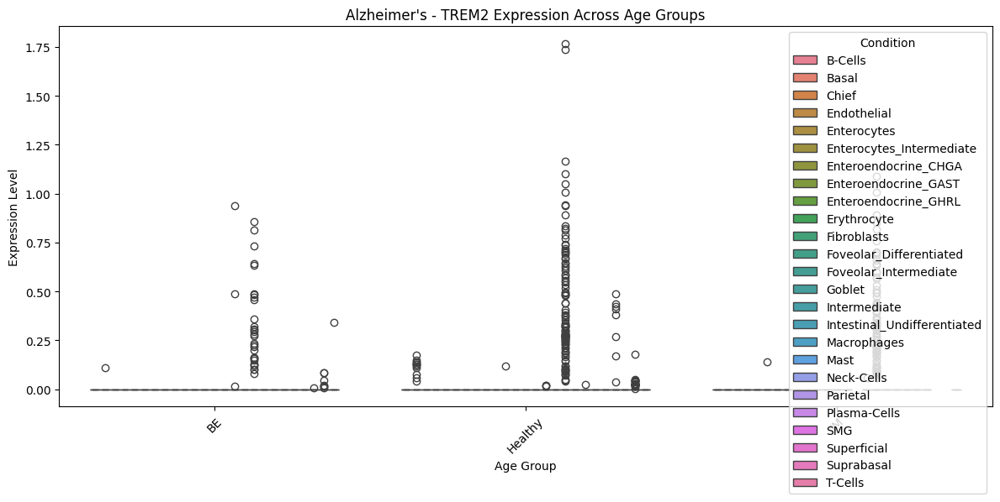

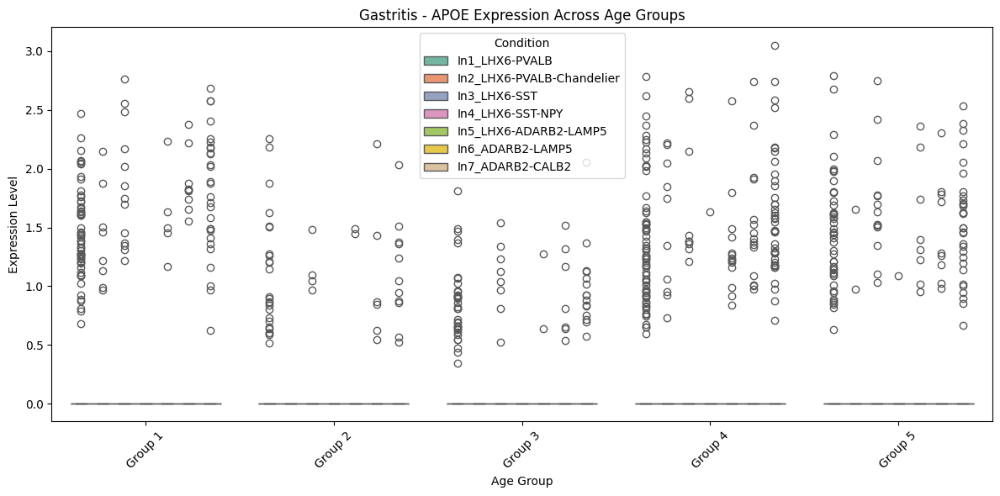

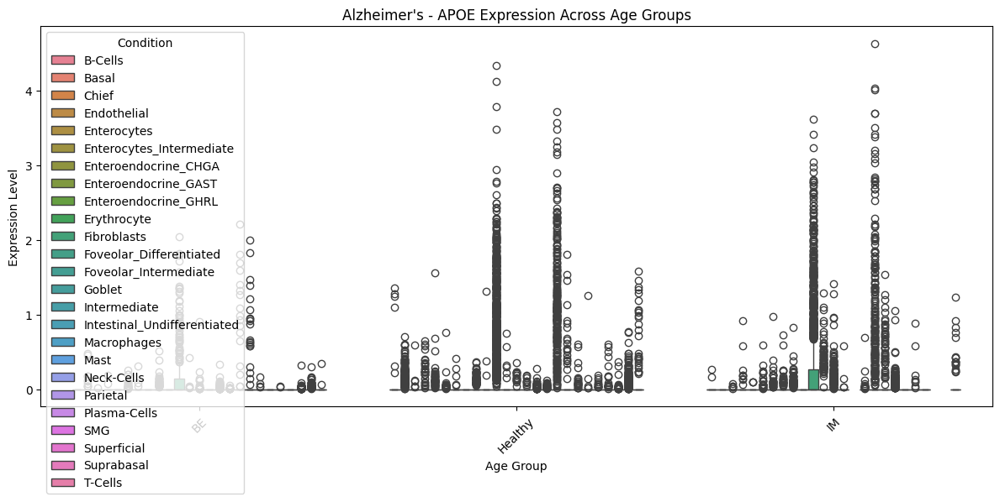

In [36]:
# Plot gene expression trends
for gene in genes_of_interest.keys():
    plot_gene_expression_trend(gastritis_gene_data, gene, 'Gastritis')
    plot_gene_expression_trend(alzheimers_gene_data, gene, 'Alzheimer\'s')

# Function to perform statistical test across age groups
def age_group_statistical_test(data, gene):
    age_groups = data['age_group'].unique()
    results = []
    for group in age_groups:
        group_data = data[data['age_group'] == group]
        conditions = group_data['condition'].unique()
        if len(conditions) >= 2:
            condition1 = conditions[0]
            condition2 = conditions[1]
            group1 = group_data[group_data['condition'] == condition1][gene]
            group2 = group_data[group_data['condition'] == condition2][gene]
            t_stat, p_value = stats.ttest_ind(group1, group2)
            results.append({'Age Group': group, 'T-statistic': t_stat, 'P-value': p_value})
    return pd.DataFrame(results)

In [37]:
# Perform statistical tests
for dataset_name, dataset in [('Gastritis', gastritis_gene_data), ('Alzheimer\'s', alzheimers_gene_data)]:
    print(f"\nStatistical tests for {dataset_name}:")
    for gene in genes_of_interest.keys():
        print(f"\n{gene} expression across age groups:")
        print(age_group_statistical_test(dataset, gene))

# Function to create a heatmap of gene expression across age groups
def plot_gene_expression_heatmap(data, gene, title):
    pivot_data = data.pivot_table(values=gene, index='condition', columns='age_group', aggfunc='mean')
    plt.figure(figsize=(12, 6))
    sns.heatmap(pivot_data, annot=True, cmap='YlOrRd', fmt='.2f')
    plt.title(f'{title} - {gene} Expression Heatmap Across Age Groups')
    plt.tight_layout()
    plt.show()


Statistical tests for Gastritis:

TREM2 expression across age groups:
  Age Group  T-statistic   P-value
0   Group 4          NaN       NaN
1   Group 1          NaN       NaN
2   Group 5     1.268153  0.204894
3   Group 2          NaN       NaN
4   Group 3          NaN       NaN

APOE expression across age groups:
  Age Group  T-statistic   P-value
0   Group 4     0.928823  0.353077
1   Group 1     0.331126  0.740573
2   Group 5     0.734776  0.462564
3   Group 2     1.265696  0.205770
4   Group 3     0.312988  0.754322

Statistical tests for Alzheimer's:

TREM2 expression across age groups:
  Age Group  T-statistic   P-value
0   Healthy    -1.781015  0.074936
1        BE    -3.685372  0.000232
2        IM          NaN       NaN

APOE expression across age groups:
  Age Group  T-statistic       P-value
0   Healthy    -1.800426  7.181863e-02
1        BE    -6.536010  7.383723e-11
2        IM     2.043686  4.099569e-02


<ipython-input-37-facf8c043ed5>:10: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



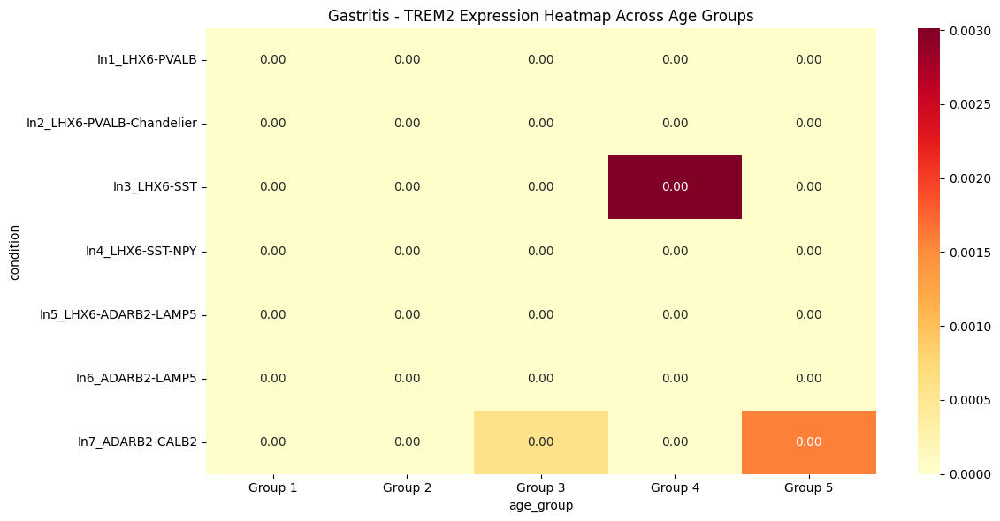

<ipython-input-37-facf8c043ed5>:10: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



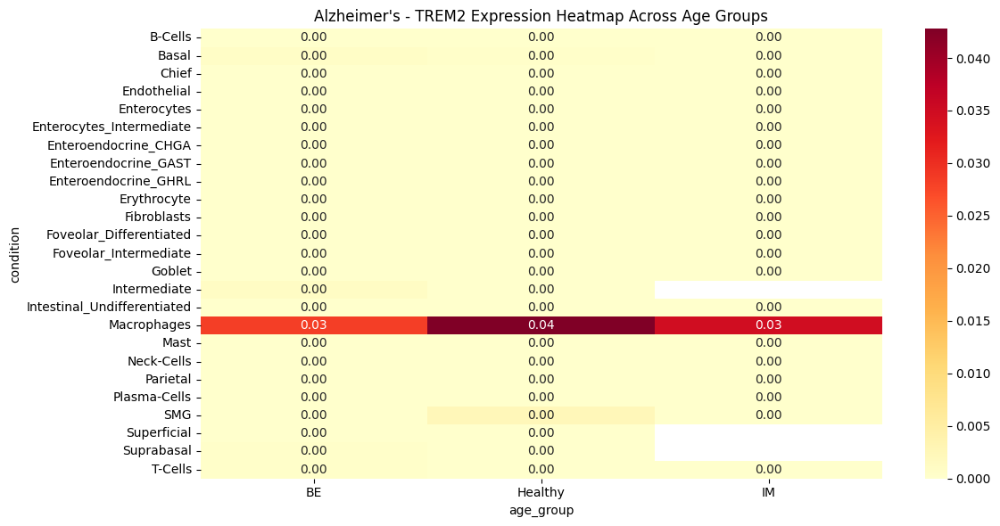

<ipython-input-37-facf8c043ed5>:10: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



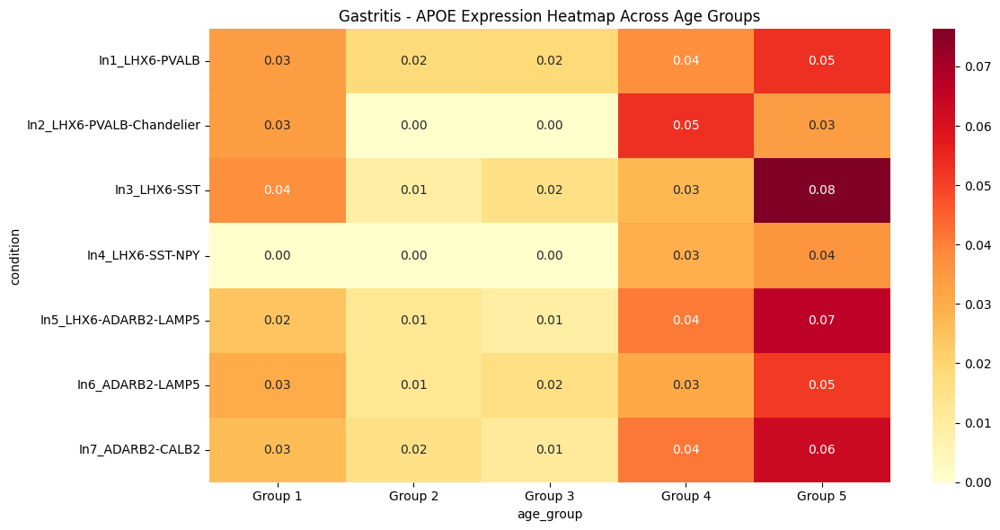

<ipython-input-37-facf8c043ed5>:10: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



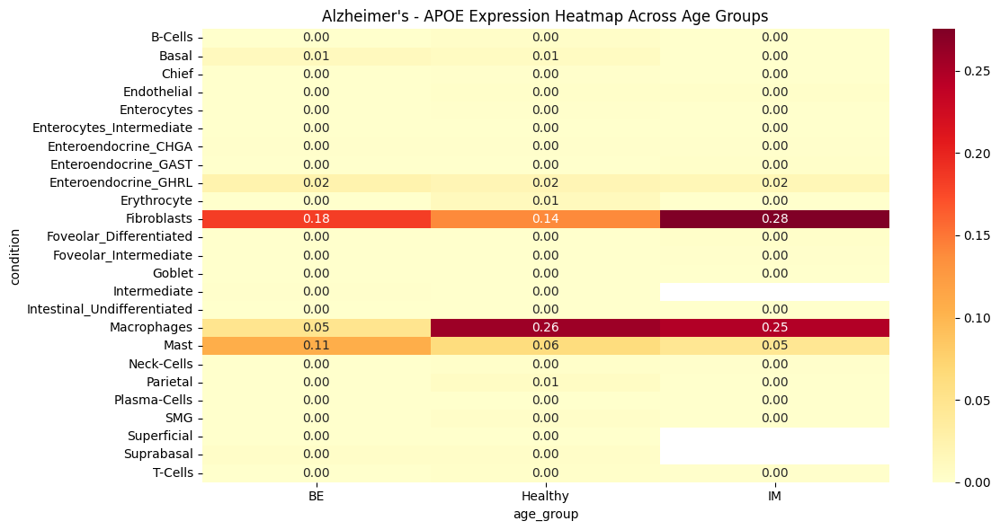

In [38]:
# Plot heatmaps
for gene in genes_of_interest.keys():
    plot_gene_expression_heatmap(gastritis_gene_data, gene, 'Gastritis')
    plot_gene_expression_heatmap(alzheimers_gene_data, gene, 'Alzheimer\'s')

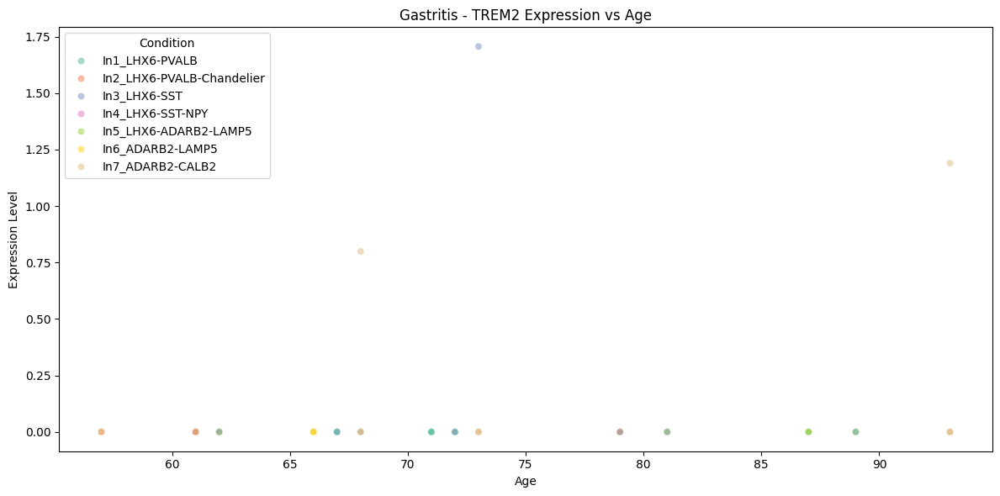

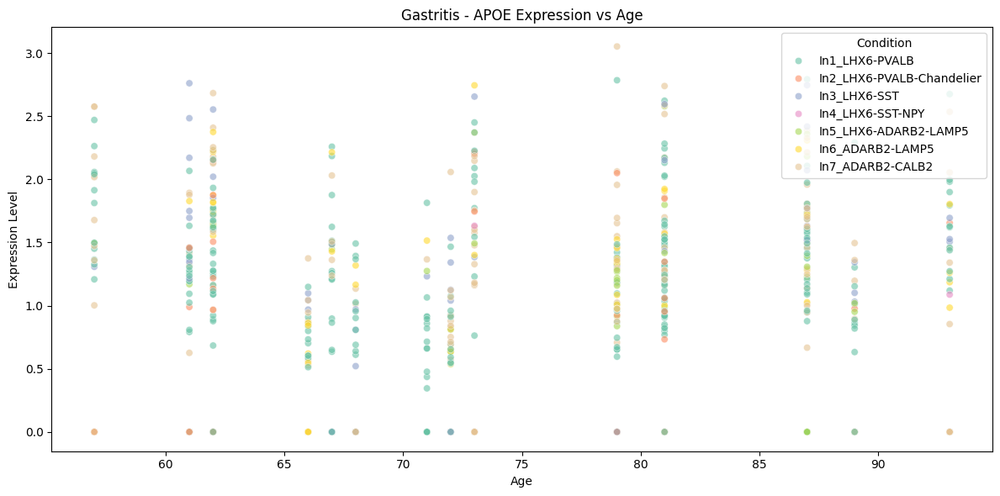

In [39]:
# Function to create a scatter plot of gene expression vs age
def plot_gene_expression_scatter(data, gene, title):
    plt.figure(figsize=(12, 6))
    sns.scatterplot(x='Age', y=gene, data=data, hue='condition', alpha=0.6)
    plt.title(f'{title} - {gene} Expression vs Age')
    plt.xlabel('Age')
    plt.ylabel('Expression Level')
    plt.legend(title='Condition')
    plt.tight_layout()
    plt.show()

# Plot scatter plots (only for Gastritis, as Alzheimer's uses Patient_status instead of actual age)
for gene in genes_of_interest.keys():
    plot_gene_expression_scatter(gastritis_gene_data, gene, 'Gastritis')